In [6]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np

In [7]:
image_dir = "/kaggle/input/celeba/img_align_celeba"

def load_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, (64, 64))
    image = tf.cast(image, tf.float32) / 255.0  # Normalize
    return image

image_paths = tf.data.Dataset.list_files(image_dir + "/*.jpg")
celebA_dataset = image_paths.map(load_image)

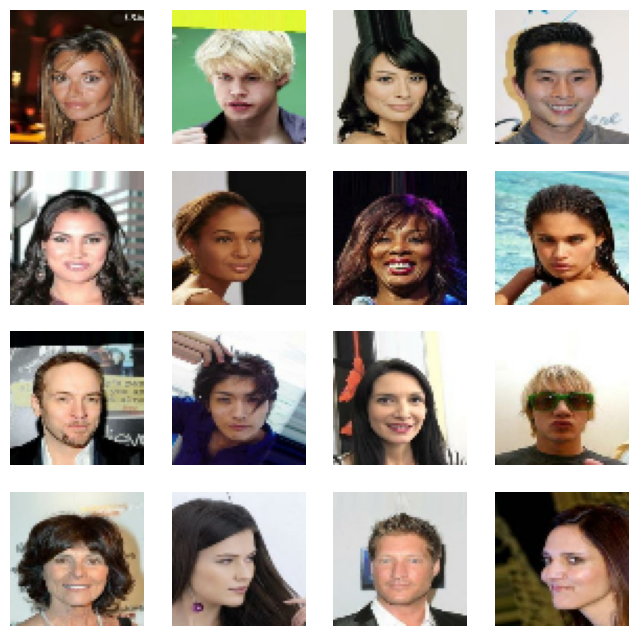

In [8]:
def visualize_data(dataset):
    plt.figure(figsize=(8, 8))
    for i, image in enumerate(dataset.take(16)):
        # display(image["image"].shape)
        plt.subplot(4, 4, i + 1)
        plt.imshow(image)  # De-normalize for visualization
        plt.axis('off')
    plt.show()

visualize_data(celebA_dataset)

In [9]:
class Discriminator(tf.keras.Model):
    def __init__(self,LATENT_DIM):
        super(Discriminator,self).__init__()

        self.discriminator=tf.keras.models.Sequential([
            tf.keras.layers.InputLayer(shape=(64, 64, 3)),
            tf.keras.layers.Conv2D(32,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Conv2D(64,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Conv2D(128,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Conv2D(256,(3,3),strides=2,activation="relu"),
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(LATENT_DIM)
        ])

    def call(self,inputs):
        return self.discriminator(inputs)
    
class Generator(tf.keras.Model):
    def __init__(self,LATENT_DIM):
        super(Generator,self).__init__()

        self.generator=tf.keras.Sequential([
            tf.keras.layers.InputLayer(shape=(LATENT_DIM,)),
            tf.keras.layers.Dense(3*3*256,activation="relu"),
            tf.keras.layers.Reshape(target_shape=(3,3,256)),
            tf.keras.layers.Conv2DTranspose(128,(3,3),strides=2,activation="relu",padding="valid"),
            tf.keras.layers.Conv2DTranspose(64,(3,3),strides=2,activation="relu",padding="valid"),
            tf.keras.layers.Conv2DTranspose(32,(3,3),strides=2,activation="relu",padding="valid"),
            tf.keras.layers.Conv2DTranspose(3,(3,3),strides=2,activation="relu",padding="valid")
        ])

    def call(self,inputs):
        return self.generator(inputs)
    
Discriminator(64).discriminator.summary()
Generator(64).generator.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)                    │ (None, 31, 31, 32)          │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_9 (Conv2D)                    │ (None, 15, 15, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 7, 7, 128)           │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 3, 3, 256)           │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 2304)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 64)                  │         147,520 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 535,936 (2.04 MB)

 Trainable params: 535,936 (2.04 MB)

 Non-trainable params: 0 (0.00 B)

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_5 (Dense)                      │ (None, 2304)                │         149,760 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_2 (Reshape)                  │ (None, 3, 3, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_8 (Conv2DTranspose) │ (None, 7, 7, 128)           │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_9 (Conv2DTranspose) │ (None, 15, 15, 64)          │          73,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_10                  │ (None, 31, 31, 32)          │          18,464 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_11                  │ (None, 63, 63, 3)           │             867 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 537,923 (2.05 MB)

 Trainable params: 537,923 (2.05 MB)

 Non-trainable params: 0 (0.00 B)

In [10]:
class GAN(tf.keras.Model):
    def __init__(self,discriminator,generator,latent_dim):
        super(GAN,self).__init__()
        self.discriminator=discriminator
        self.generator=generator
        self.latent_dim=latent_dim
    
    def compile(self,disc_optimizer,gen_optimizer,loss_fn,batch_size):
        super(GAN,self).compile()
        self.disc_optimizer=disc_optimizer
        self.gen_optimizer=gen_optimizer
        self.loss_fn=loss_fn
        self.batch_size=batch_size
        # self.generator_loss=generator_loss
        # self.discriminator_loss=discriminator_loss

    @tf.function
    def train_step(self,inputs):
        images=inputs
        noise=tf.random.normal([self.batch_size,self.latent_dim])

        with tf.GradientTape(persistent=True) as tape:
            generated_image=self.generator(noise)
            real_output=self.discriminator(images)
            fake_output=self.discriminator(generated_image)

            gen_loss=self.loss_fn(tf.ones_like(fake_output),fake_output)
            disc_loss=self.loss_fn(tf.ones_like(real_output),real_output)+self.loss_fn(tf.zeros_like(fake_output),fake_output)

        grad_disc=tape.gradient(disc_loss,self.discriminator.trainable_variables)
        grad_gen=tape.gradient(gen_loss,self.generator.trainable_variables)

        self.disc_optimizer.apply_gradients(zip(grad_disc,self.discriminator.trainable_variables))
        self.gen_optimizer.apply_gradients(zip(grad_gen,self.generator.trainable_variables))

        return {"Gen Loss":gen_loss,"Disc Loss":disc_loss}

In [11]:
class Training_Callback(tf.keras.callbacks.Callback):
    def __init__(self,latent_dim):
        super(Training_Callback,self).__init__()
        self.latent_dim=latent_dim

    def show_imgs(self):
        seed=tf.random.normal([4,self.latent_dim])
        gen_imgs=self.model.generator(seed)

        plt.figure(figsize=(8,8))
        for i in range(gen_imgs.shape[0]):
            plt.subplot(1,4,i+1)
            plt.imshow(gen_imgs[i])
            plt.axis('off')
        plt.show()
    
    def on_epoch_end(self,epoch,logs=None):
        self.show_imgs()

In [12]:
LATENT_DIM=64
epochs=200

batch_size=1000

buffer_size=5000

gen_optimizer=tf.keras.optimizers.Adam(0.0001)
disc_optimizer=tf.keras.optimizers.Adam(0.0001)

celebA_dataset=celebA_dataset.shuffle(buffer_size,reshuffle_each_iteration=True).batch(batch_size).prefetch(tf.data.AUTOTUNE)
cross_entropy=tf.keras.losses.BinaryCrossentropy(from_logits=True)

Epoch 1/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - Disc Loss: 0.5250 - Gen Loss: 2.0556

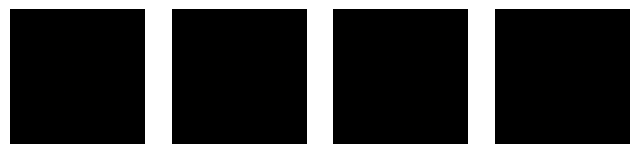

203/203 ━━━━━━━━━━━━━━━━━━━━ 302s 1s/step - Disc Loss: 0.5224 - Gen Loss: 2.0755
Epoch 2/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - Disc Loss: 0.8540 - Gen Loss: 5.9133

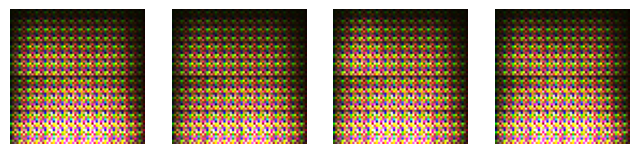

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 319ms/step - Disc Loss: 0.8521 - Gen Loss: 5.8959
Epoch 3/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step - Disc Loss: 0.5659 - Gen Loss: 1.9427

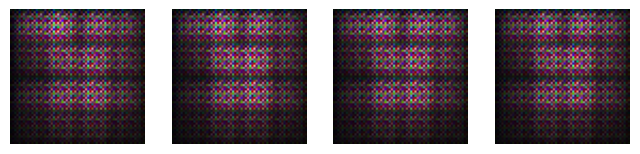

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 344ms/step - Disc Loss: 0.5664 - Gen Loss: 1.9403
Epoch 4/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step - Disc Loss: 0.6362 - Gen Loss: 1.6773

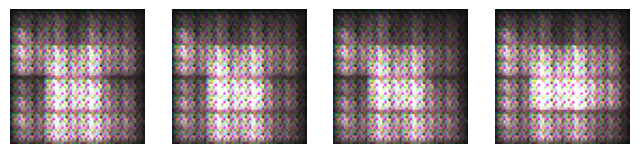

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 332ms/step - Disc Loss: 0.6358 - Gen Loss: 1.6793
Epoch 5/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step - Disc Loss: 0.7205 - Gen Loss: 1.4578

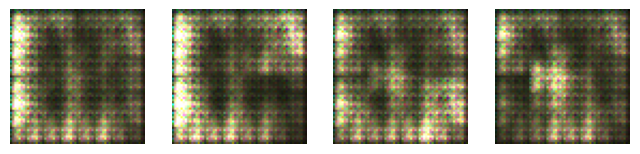

203/203 ━━━━━━━━━━━━━━━━━━━━ 75s 358ms/step - Disc Loss: 0.7217 - Gen Loss: 1.4581
Epoch 6/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step - Disc Loss: 1.2179 - Gen Loss: 1.3341

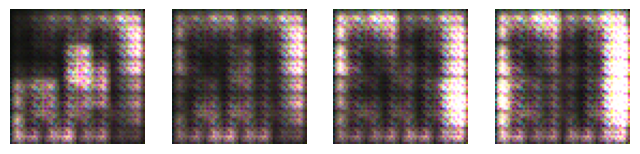

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 365ms/step - Disc Loss: 1.2200 - Gen Loss: 1.3319
Epoch 7/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - Disc Loss: 1.1372 - Gen Loss: 1.5101

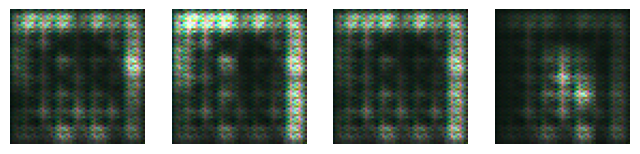

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 311ms/step - Disc Loss: 1.1329 - Gen Loss: 1.5125
Epoch 8/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - Disc Loss: 0.8307 - Gen Loss: 1.7819

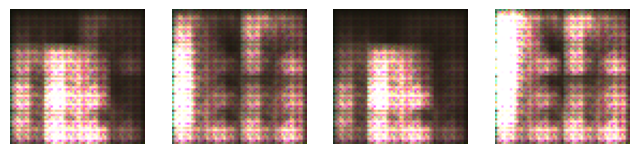

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 315ms/step - Disc Loss: 0.8301 - Gen Loss: 1.7817
Epoch 9/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step - Disc Loss: 0.9267 - Gen Loss: 1.2281

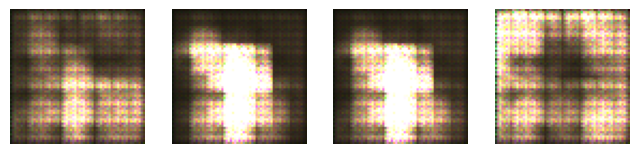

203/203 ━━━━━━━━━━━━━━━━━━━━ 99s 478ms/step - Disc Loss: 0.9250 - Gen Loss: 1.2319
Epoch 10/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - Disc Loss: 0.5709 - Gen Loss: 2.1789

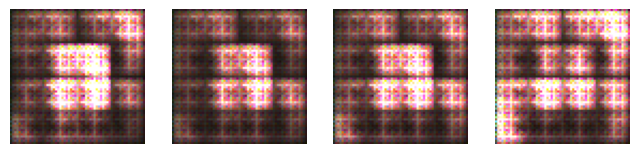

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 340ms/step - Disc Loss: 0.5712 - Gen Loss: 2.1774
Epoch 11/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - Disc Loss: 0.8802 - Gen Loss: 1.4844

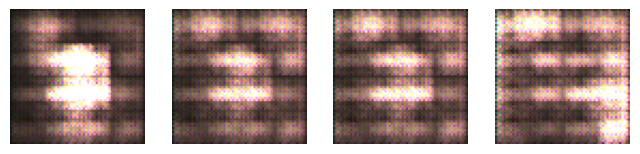

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 345ms/step - Disc Loss: 0.8775 - Gen Loss: 1.4881
Epoch 12/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step - Disc Loss: 0.6689 - Gen Loss: 1.5347

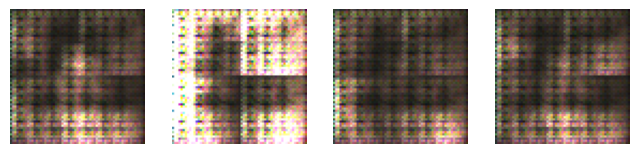

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 370ms/step - Disc Loss: 0.6677 - Gen Loss: 1.5366
Epoch 13/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step - Disc Loss: 0.3704 - Gen Loss: 2.5259

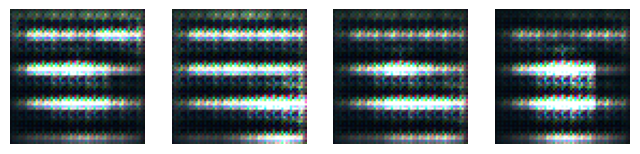

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 326ms/step - Disc Loss: 0.3699 - Gen Loss: 2.5327
Epoch 14/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - Disc Loss: 0.4881 - Gen Loss: 2.7426

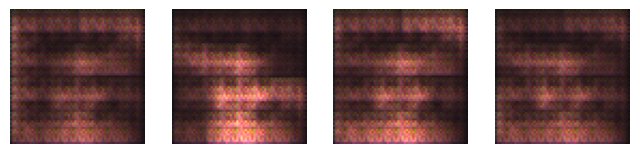

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 324ms/step - Disc Loss: 0.4898 - Gen Loss: 2.7355
Epoch 15/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - Disc Loss: 0.6092 - Gen Loss: 1.6074

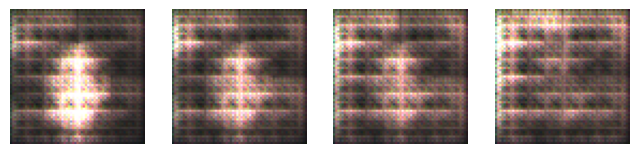

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 340ms/step - Disc Loss: 0.6089 - Gen Loss: 1.6077
Epoch 16/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step - Disc Loss: 0.4448 - Gen Loss: 1.9035

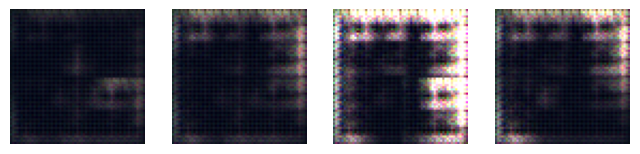

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 333ms/step - Disc Loss: 0.4441 - Gen Loss: 1.9042
Epoch 17/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - Disc Loss: 0.3844 - Gen Loss: 4.1073

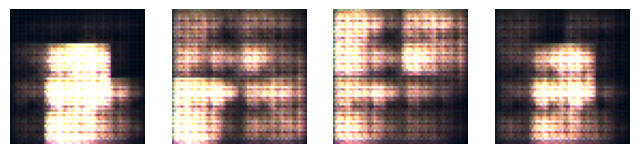

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 324ms/step - Disc Loss: 0.3923 - Gen Loss: 4.1100
Epoch 18/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step - Disc Loss: 0.4872 - Gen Loss: 2.3795

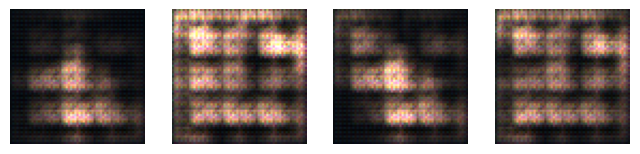

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 345ms/step - Disc Loss: 0.4867 - Gen Loss: 2.3778
Epoch 19/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - Disc Loss: 0.4011 - Gen Loss: 2.3946

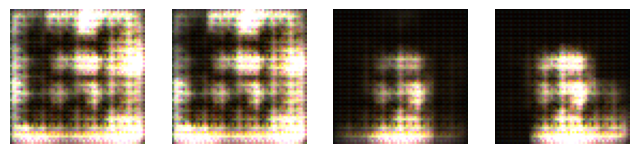

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 323ms/step - Disc Loss: 0.4013 - Gen Loss: 2.3948
Epoch 20/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step - Disc Loss: 0.4440 - Gen Loss: 2.7306

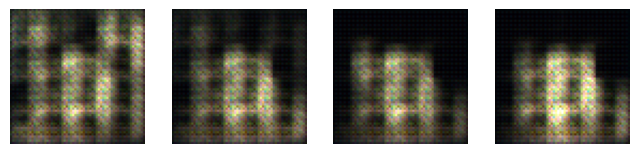

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 327ms/step - Disc Loss: 0.4452 - Gen Loss: 2.7251
Epoch 21/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - Disc Loss: 0.3789 - Gen Loss: 2.3048

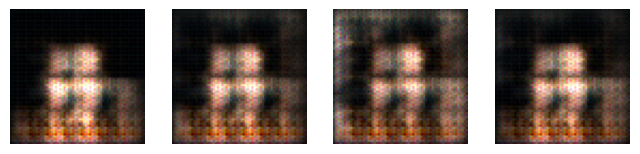

203/203 ━━━━━━━━━━━━━━━━━━━━ 64s 308ms/step - Disc Loss: 0.3795 - Gen Loss: 2.3050
Epoch 22/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - Disc Loss: 0.6587 - Gen Loss: 1.8842

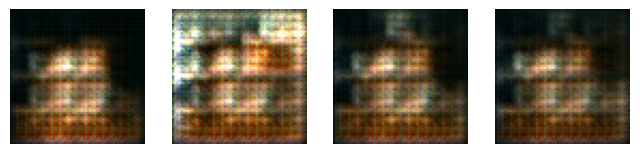

203/203 ━━━━━━━━━━━━━━━━━━━━ 64s 309ms/step - Disc Loss: 0.6597 - Gen Loss: 1.8822
Epoch 23/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.5458 - Gen Loss: 1.8888

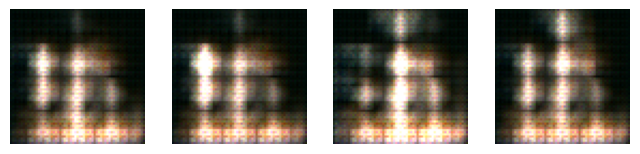

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.5453 - Gen Loss: 1.8895
Epoch 24/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step - Disc Loss: 0.5568 - Gen Loss: 2.2101

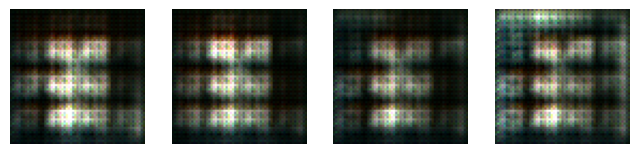

203/203 ━━━━━━━━━━━━━━━━━━━━ 81s 386ms/step - Disc Loss: 0.5561 - Gen Loss: 2.2111
Epoch 25/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - Disc Loss: 0.4835 - Gen Loss: 2.0693

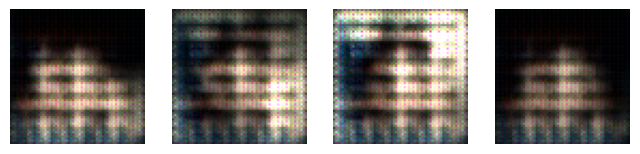

203/203 ━━━━━━━━━━━━━━━━━━━━ 64s 308ms/step - Disc Loss: 0.4841 - Gen Loss: 2.0694
Epoch 26/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 668ms/step - Disc Loss: 0.5966 - Gen Loss: 1.7560

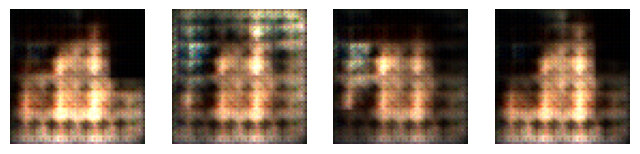

203/203 ━━━━━━━━━━━━━━━━━━━━ 138s 669ms/step - Disc Loss: 0.5964 - Gen Loss: 1.7563
Epoch 27/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step - Disc Loss: 0.6693 - Gen Loss: 1.7324

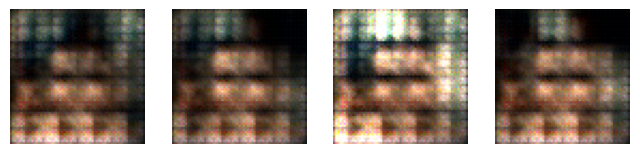

203/203 ━━━━━━━━━━━━━━━━━━━━ 95s 423ms/step - Disc Loss: 0.6689 - Gen Loss: 1.7328
Epoch 28/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 407ms/step - Disc Loss: 0.6092 - Gen Loss: 1.8267

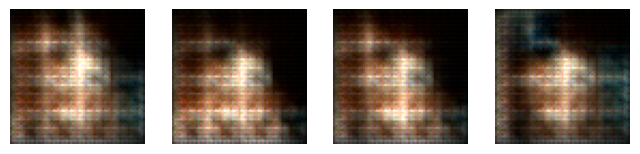

203/203 ━━━━━━━━━━━━━━━━━━━━ 85s 408ms/step - Disc Loss: 0.6093 - Gen Loss: 1.8251
Epoch 29/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step - Disc Loss: 0.5439 - Gen Loss: 1.6789

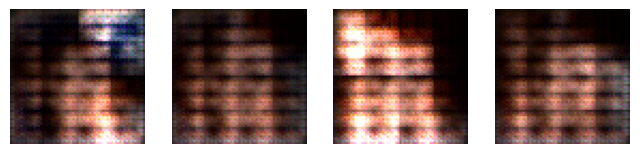

203/203 ━━━━━━━━━━━━━━━━━━━━ 75s 356ms/step - Disc Loss: 0.5427 - Gen Loss: 1.6827
Epoch 30/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step - Disc Loss: 0.7981 - Gen Loss: 2.0036

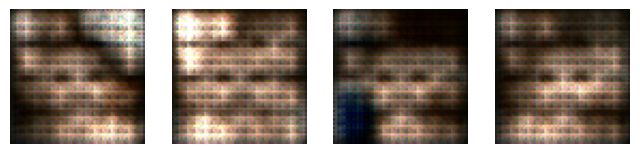

203/203 ━━━━━━━━━━━━━━━━━━━━ 85s 410ms/step - Disc Loss: 0.8000 - Gen Loss: 1.9992
Epoch 31/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step - Disc Loss: 0.3332 - Gen Loss: 2.3179

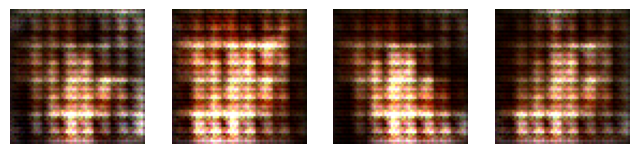

203/203 ━━━━━━━━━━━━━━━━━━━━ 80s 386ms/step - Disc Loss: 0.3326 - Gen Loss: 2.3228
Epoch 32/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step - Disc Loss: 0.6637 - Gen Loss: 2.0315

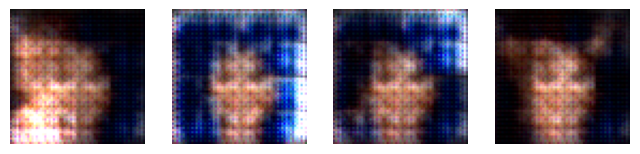

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 334ms/step - Disc Loss: 0.6642 - Gen Loss: 2.0310
Epoch 33/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step - Disc Loss: 0.6127 - Gen Loss: 1.7119

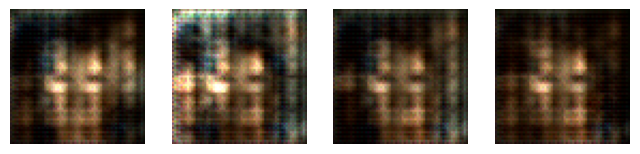

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 331ms/step - Disc Loss: 0.6111 - Gen Loss: 1.7142
Epoch 34/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step - Disc Loss: 0.5415 - Gen Loss: 1.9751

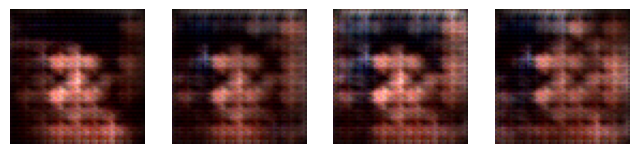

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 346ms/step - Disc Loss: 0.5408 - Gen Loss: 1.9753
Epoch 35/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step - Disc Loss: 0.5046 - Gen Loss: 1.9298

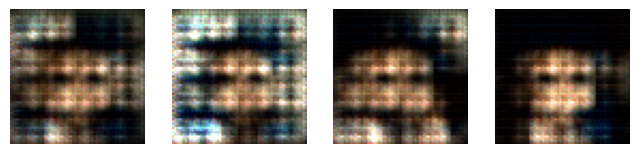

203/203 ━━━━━━━━━━━━━━━━━━━━ 105s 498ms/step - Disc Loss: 0.5040 - Gen Loss: 1.9331
Epoch 36/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step - Disc Loss: 0.6106 - Gen Loss: 2.2409

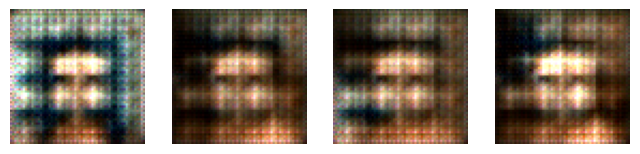

203/203 ━━━━━━━━━━━━━━━━━━━━ 80s 376ms/step - Disc Loss: 0.6099 - Gen Loss: 2.2404
Epoch 37/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step - Disc Loss: 0.4923 - Gen Loss: 2.1111

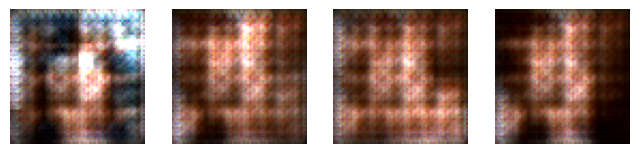

203/203 ━━━━━━━━━━━━━━━━━━━━ 75s 359ms/step - Disc Loss: 0.4922 - Gen Loss: 2.1116
Epoch 38/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.5177 - Gen Loss: 1.9253

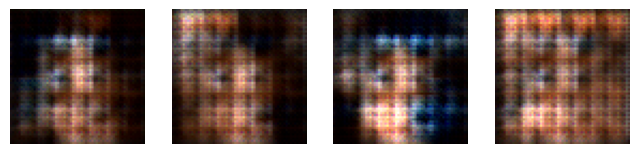

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.5175 - Gen Loss: 1.9254
Epoch 39/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step - Disc Loss: 0.5541 - Gen Loss: 2.2316

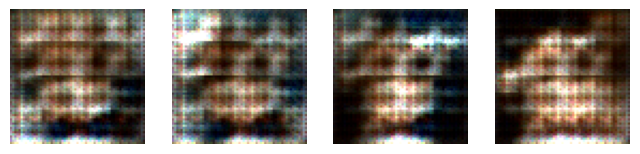

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 344ms/step - Disc Loss: 0.5566 - Gen Loss: 2.2272
Epoch 40/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - Disc Loss: 0.4841 - Gen Loss: 2.2096

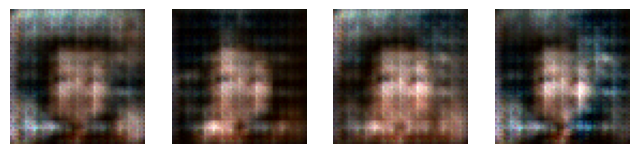

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.4843 - Gen Loss: 2.2094
Epoch 41/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - Disc Loss: 0.5970 - Gen Loss: 2.1002

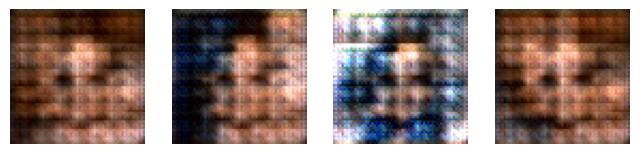

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 320ms/step - Disc Loss: 0.5964 - Gen Loss: 2.0980
Epoch 42/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - Disc Loss: 0.5848 - Gen Loss: 1.8199

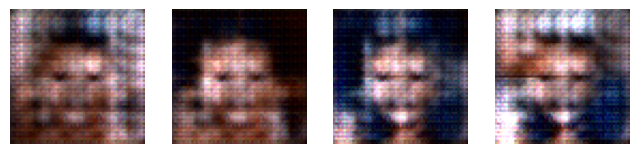

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 312ms/step - Disc Loss: 0.5843 - Gen Loss: 1.8225
Epoch 43/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - Disc Loss: 0.5332 - Gen Loss: 1.9326

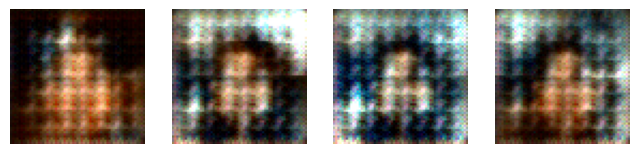

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 312ms/step - Disc Loss: 0.5346 - Gen Loss: 1.9309
Epoch 44/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step - Disc Loss: 0.7251 - Gen Loss: 1.9399

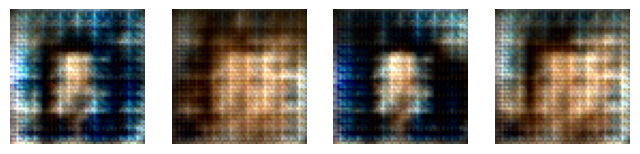

203/203 ━━━━━━━━━━━━━━━━━━━━ 75s 359ms/step - Disc Loss: 0.7260 - Gen Loss: 1.9389
Epoch 45/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 382ms/step - Disc Loss: 0.4868 - Gen Loss: 2.0528

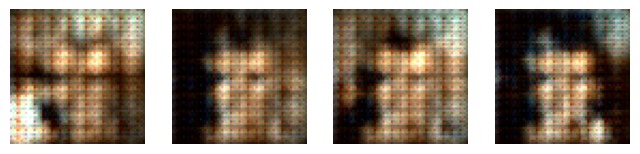

203/203 ━━━━━━━━━━━━━━━━━━━━ 82s 382ms/step - Disc Loss: 0.4858 - Gen Loss: 2.0541
Epoch 46/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step - Disc Loss: 0.5814 - Gen Loss: 2.1972

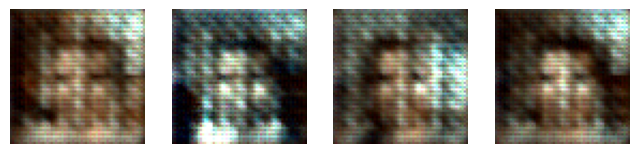

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 331ms/step - Disc Loss: 0.5806 - Gen Loss: 2.1959
Epoch 47/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 367ms/step - Disc Loss: 0.3442 - Gen Loss: 2.9772

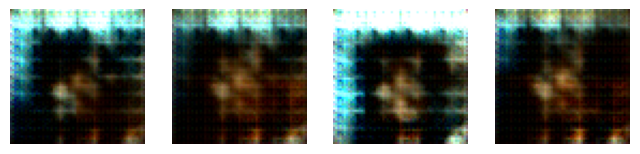

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 369ms/step - Disc Loss: 0.3438 - Gen Loss: 2.9878
Epoch 48/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step - Disc Loss: 0.4969 - Gen Loss: 2.9931

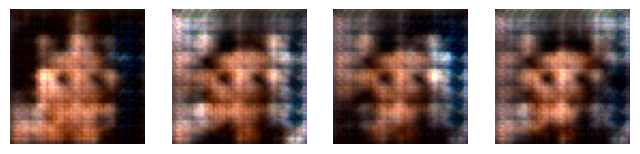

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 371ms/step - Disc Loss: 0.4960 - Gen Loss: 2.9934
Epoch 49/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step - Disc Loss: 0.3879 - Gen Loss: 2.3517

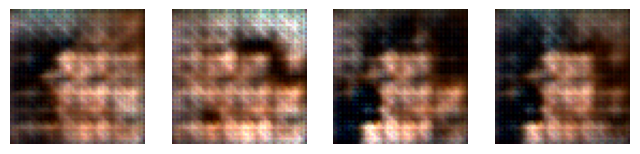

203/203 ━━━━━━━━━━━━━━━━━━━━ 90s 436ms/step - Disc Loss: 0.3880 - Gen Loss: 2.3522
Epoch 50/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step - Disc Loss: 0.4946 - Gen Loss: 2.0310

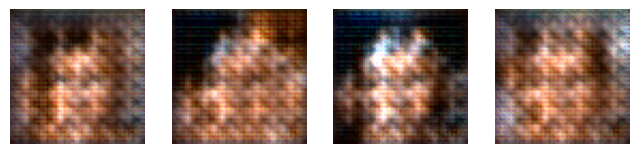

203/203 ━━━━━━━━━━━━━━━━━━━━ 95s 462ms/step - Disc Loss: 0.4942 - Gen Loss: 2.0306
Epoch 51/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 349ms/step - Disc Loss: 0.4515 - Gen Loss: 2.1943

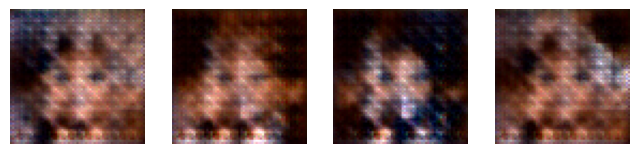

203/203 ━━━━━━━━━━━━━━━━━━━━ 73s 350ms/step - Disc Loss: 0.4526 - Gen Loss: 2.1944
Epoch 52/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 605ms/step - Disc Loss: 0.5102 - Gen Loss: 2.3252

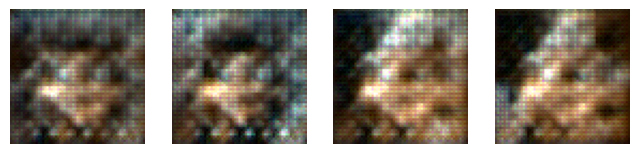

203/203 ━━━━━━━━━━━━━━━━━━━━ 125s 606ms/step - Disc Loss: 0.5102 - Gen Loss: 2.3248
Epoch 53/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step - Disc Loss: 0.6108 - Gen Loss: 2.0628

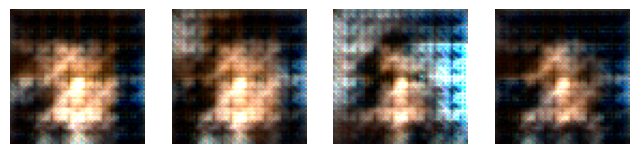

203/203 ━━━━━━━━━━━━━━━━━━━━ 81s 389ms/step - Disc Loss: 0.6099 - Gen Loss: 2.0627
Epoch 54/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step - Disc Loss: 0.5643 - Gen Loss: 2.3238

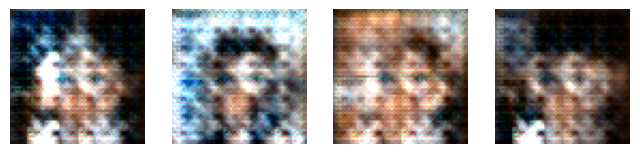

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 332ms/step - Disc Loss: 0.5642 - Gen Loss: 2.3223
Epoch 55/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step - Disc Loss: 0.6694 - Gen Loss: 1.8649

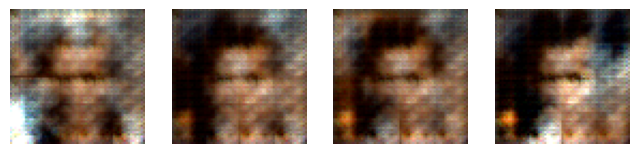

203/203 ━━━━━━━━━━━━━━━━━━━━ 84s 407ms/step - Disc Loss: 0.6686 - Gen Loss: 1.8639
Epoch 56/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step - Disc Loss: 0.5473 - Gen Loss: 1.9617

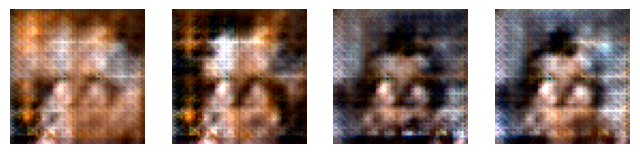

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 362ms/step - Disc Loss: 0.5460 - Gen Loss: 1.9667
Epoch 57/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 392ms/step - Disc Loss: 0.4776 - Gen Loss: 2.3026

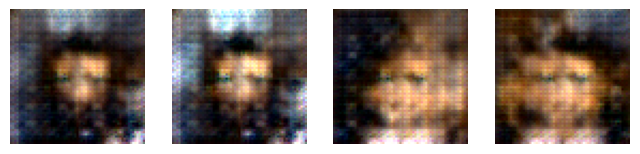

203/203 ━━━━━━━━━━━━━━━━━━━━ 82s 393ms/step - Disc Loss: 0.4775 - Gen Loss: 2.3095
Epoch 58/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step - Disc Loss: 0.6551 - Gen Loss: 1.9845

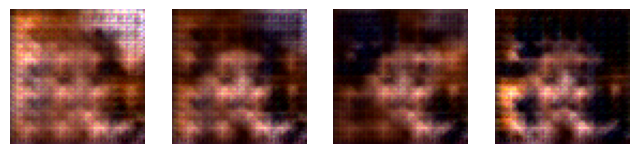

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 342ms/step - Disc Loss: 0.6550 - Gen Loss: 1.9826
Epoch 59/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 333ms/step - Disc Loss: 0.6139 - Gen Loss: 2.3064

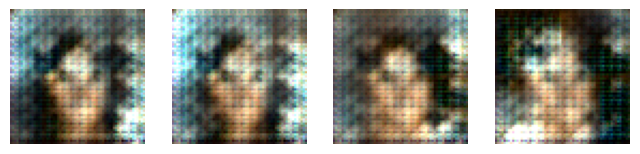

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 334ms/step - Disc Loss: 0.6128 - Gen Loss: 2.3061
Epoch 60/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step - Disc Loss: 0.5567 - Gen Loss: 1.9457

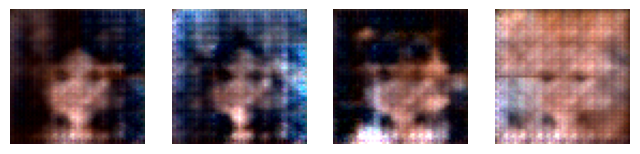

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 338ms/step - Disc Loss: 0.5558 - Gen Loss: 1.9457
Epoch 61/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step - Disc Loss: 0.4707 - Gen Loss: 2.0276

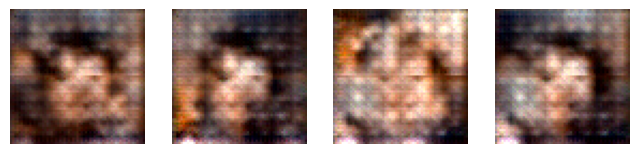

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 334ms/step - Disc Loss: 0.4705 - Gen Loss: 2.0270
Epoch 62/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step - Disc Loss: 0.4688 - Gen Loss: 2.2095

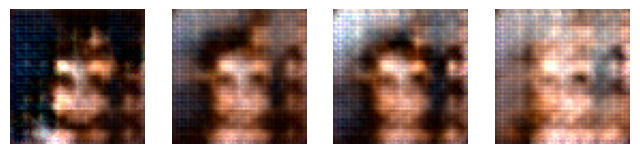

203/203 ━━━━━━━━━━━━━━━━━━━━ 73s 352ms/step - Disc Loss: 0.4680 - Gen Loss: 2.2132
Epoch 63/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step - Disc Loss: 0.4965 - Gen Loss: 2.2738

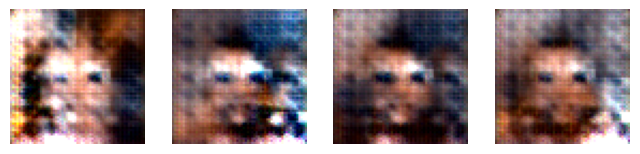

203/203 ━━━━━━━━━━━━━━━━━━━━ 94s 455ms/step - Disc Loss: 0.4963 - Gen Loss: 2.2753
Epoch 64/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 336ms/step - Disc Loss: 0.6252 - Gen Loss: 2.1573

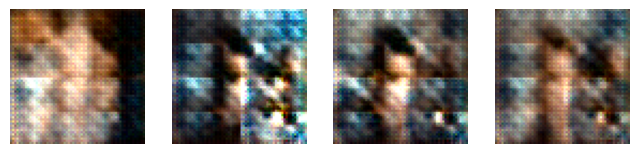

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 337ms/step - Disc Loss: 0.6265 - Gen Loss: 2.1569
Epoch 65/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step - Disc Loss: 0.5090 - Gen Loss: 2.2221

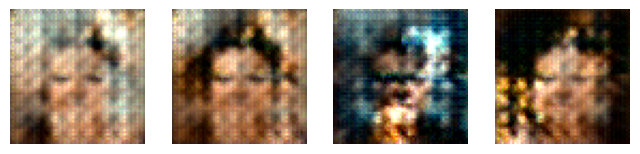

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 330ms/step - Disc Loss: 0.5081 - Gen Loss: 2.2270
Epoch 66/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step - Disc Loss: 0.5814 - Gen Loss: 2.0081

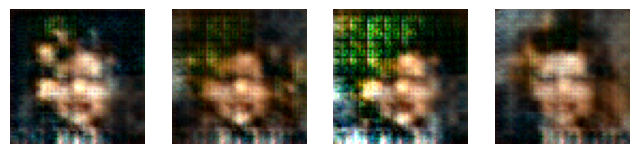

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 326ms/step - Disc Loss: 0.5813 - Gen Loss: 2.0075
Epoch 67/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step - Disc Loss: 0.5567 - Gen Loss: 2.3156

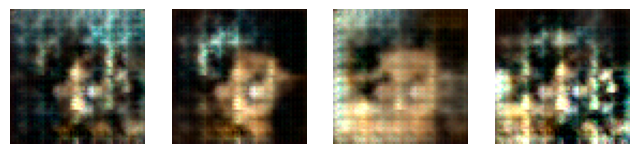

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 332ms/step - Disc Loss: 0.5561 - Gen Loss: 2.3155
Epoch 68/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step - Disc Loss: 0.4801 - Gen Loss: 2.4780

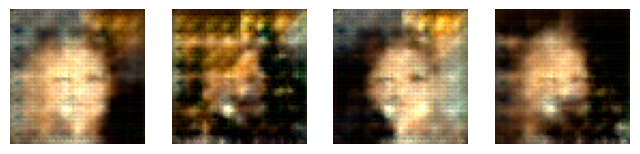

203/203 ━━━━━━━━━━━━━━━━━━━━ 86s 415ms/step - Disc Loss: 0.4803 - Gen Loss: 2.4770
Epoch 69/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 426ms/step - Disc Loss: 0.5224 - Gen Loss: 2.6844

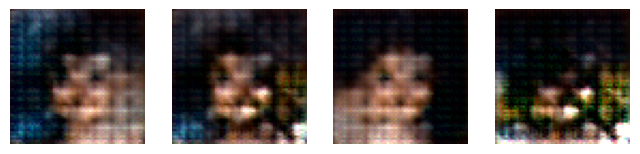

203/203 ━━━━━━━━━━━━━━━━━━━━ 89s 427ms/step - Disc Loss: 0.5207 - Gen Loss: 2.6879
Epoch 70/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step - Disc Loss: 0.4093 - Gen Loss: 2.5146

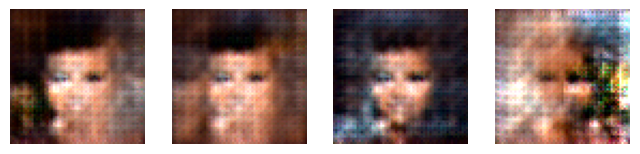

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 364ms/step - Disc Loss: 0.4087 - Gen Loss: 2.5153
Epoch 71/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 332ms/step - Disc Loss: 0.4649 - Gen Loss: 2.6423

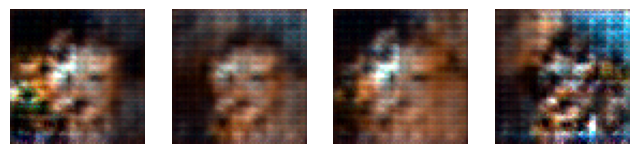

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 333ms/step - Disc Loss: 0.4647 - Gen Loss: 2.6406
Epoch 72/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step - Disc Loss: 0.4949 - Gen Loss: 2.3994

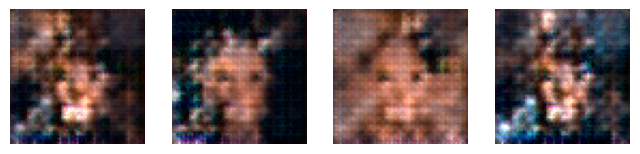

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 335ms/step - Disc Loss: 0.4949 - Gen Loss: 2.3976
Epoch 73/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step - Disc Loss: 0.4943 - Gen Loss: 2.2966

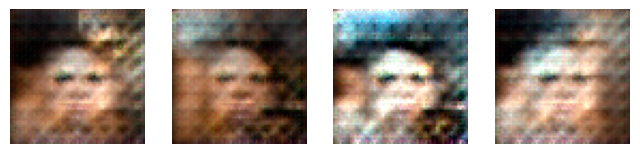

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 328ms/step - Disc Loss: 0.4938 - Gen Loss: 2.2968
Epoch 74/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - Disc Loss: 0.4534 - Gen Loss: 2.2491

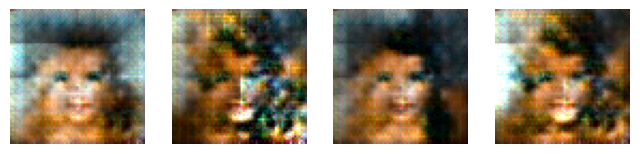

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 324ms/step - Disc Loss: 0.4522 - Gen Loss: 2.2566
Epoch 75/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step - Disc Loss: 0.7153 - Gen Loss: 2.5077

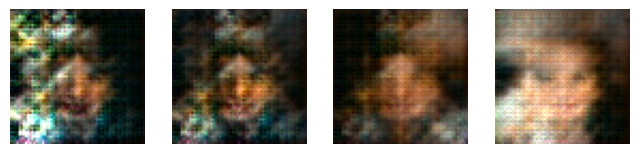

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 328ms/step - Disc Loss: 0.7161 - Gen Loss: 2.5050
Epoch 76/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step - Disc Loss: 0.5421 - Gen Loss: 2.1378

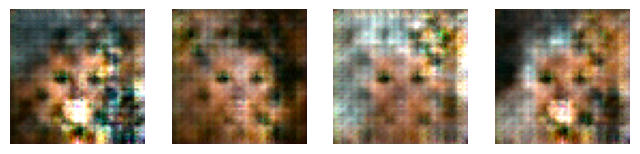

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 335ms/step - Disc Loss: 0.5422 - Gen Loss: 2.1367
Epoch 77/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step - Disc Loss: 0.4993 - Gen Loss: 2.1327

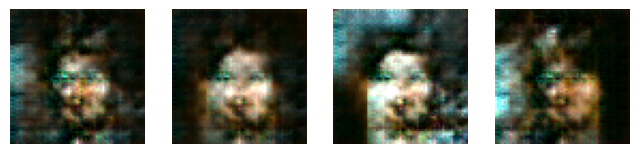

203/203 ━━━━━━━━━━━━━━━━━━━━ 89s 431ms/step - Disc Loss: 0.4992 - Gen Loss: 2.1320
Epoch 78/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step - Disc Loss: 0.5166 - Gen Loss: 2.2162

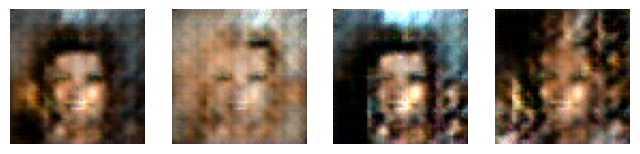

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 339ms/step - Disc Loss: 0.5161 - Gen Loss: 2.2158
Epoch 79/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step - Disc Loss: 0.5382 - Gen Loss: 2.2241

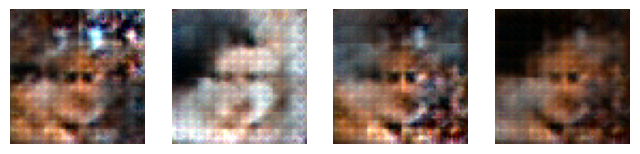

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 370ms/step - Disc Loss: 0.5377 - Gen Loss: 2.2243
Epoch 80/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step - Disc Loss: 0.5715 - Gen Loss: 2.2545

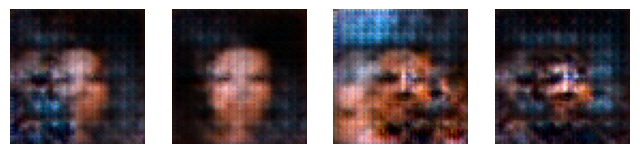

203/203 ━━━━━━━━━━━━━━━━━━━━ 80s 353ms/step - Disc Loss: 0.5713 - Gen Loss: 2.2543
Epoch 81/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 933ms/step - Disc Loss: 0.5248 - Gen Loss: 2.2166

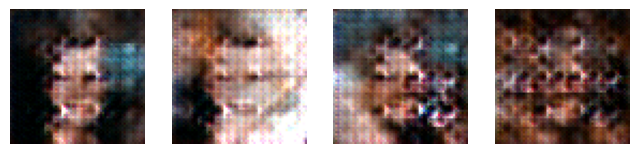

203/203 ━━━━━━━━━━━━━━━━━━━━ 192s 933ms/step - Disc Loss: 0.5232 - Gen Loss: 2.2221
Epoch 82/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - Disc Loss: 0.4182 - Gen Loss: 2.6944

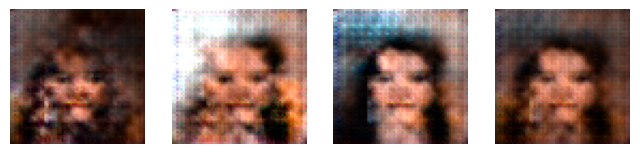

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 318ms/step - Disc Loss: 0.4183 - Gen Loss: 2.6915
Epoch 83/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.5075 - Gen Loss: 2.3465

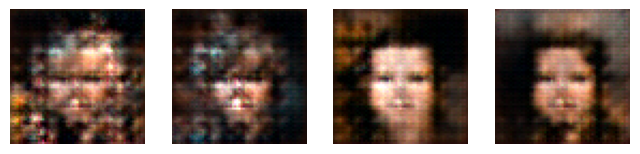

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.5066 - Gen Loss: 2.3489
Epoch 84/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - Disc Loss: 0.3997 - Gen Loss: 3.0441

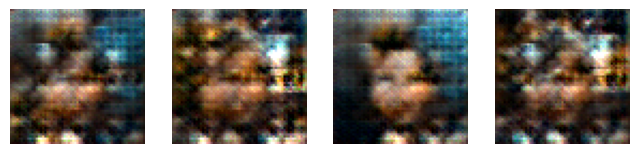

203/203 ━━━━━━━━━━━━━━━━━━━━ 87s 421ms/step - Disc Loss: 0.3999 - Gen Loss: 3.0423
Epoch 85/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - Disc Loss: 0.5002 - Gen Loss: 3.1449

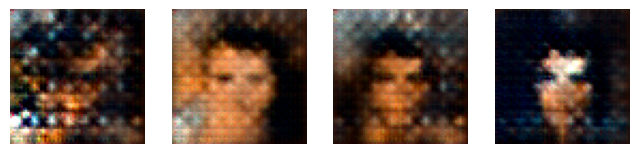

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 322ms/step - Disc Loss: 0.4985 - Gen Loss: 3.1496
Epoch 86/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - Disc Loss: 0.3922 - Gen Loss: 2.9829

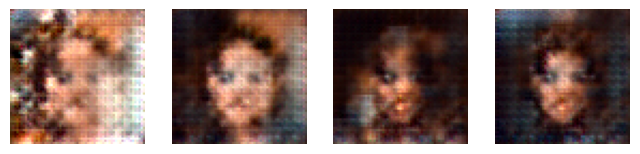

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 323ms/step - Disc Loss: 0.3919 - Gen Loss: 2.9824
Epoch 87/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step - Disc Loss: 0.3557 - Gen Loss: 2.7927

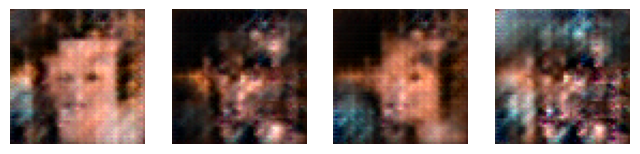

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 339ms/step - Disc Loss: 0.3555 - Gen Loss: 2.7924
Epoch 88/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - Disc Loss: 0.3539 - Gen Loss: 2.6981

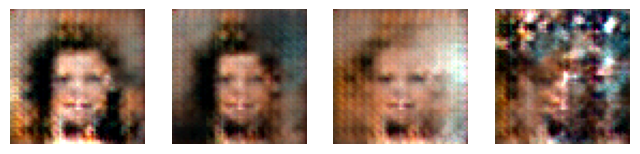

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 325ms/step - Disc Loss: 0.3532 - Gen Loss: 2.6994
Epoch 89/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - Disc Loss: 0.4247 - Gen Loss: 2.9901

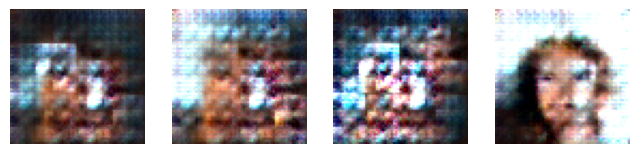

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 345ms/step - Disc Loss: 0.4257 - Gen Loss: 2.9874
Epoch 90/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step - Disc Loss: 0.3807 - Gen Loss: 2.7821

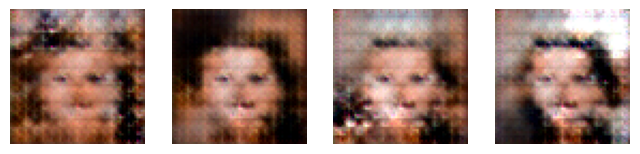

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 329ms/step - Disc Loss: 0.3806 - Gen Loss: 2.7816
Epoch 91/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.3227 - Gen Loss: 2.8108

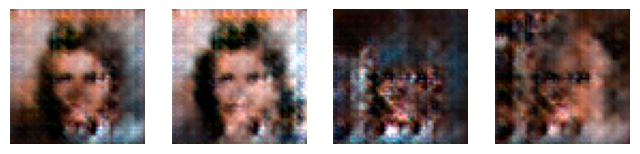

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 315ms/step - Disc Loss: 0.3227 - Gen Loss: 2.8097
Epoch 92/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step - Disc Loss: 0.3870 - Gen Loss: 2.6666

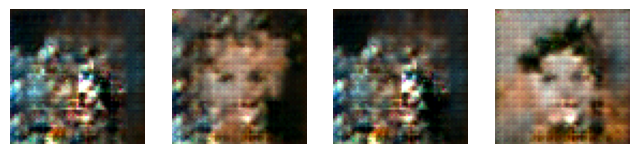

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 357ms/step - Disc Loss: 0.3857 - Gen Loss: 2.6774
Epoch 93/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - Disc Loss: 0.3883 - Gen Loss: 2.7437

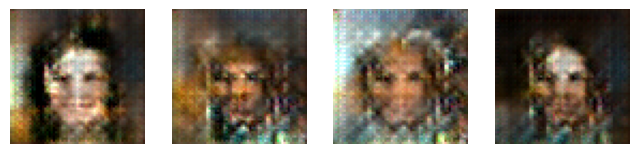

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 322ms/step - Disc Loss: 0.3880 - Gen Loss: 2.7446
Epoch 94/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - Disc Loss: 0.4052 - Gen Loss: 2.6740

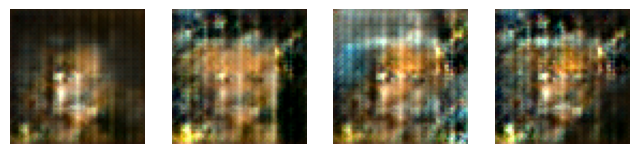

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 314ms/step - Disc Loss: 0.4054 - Gen Loss: 2.6711
Epoch 95/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - Disc Loss: 0.5186 - Gen Loss: 3.0729

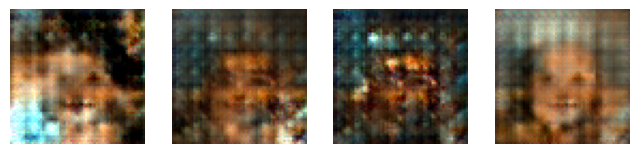

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 313ms/step - Disc Loss: 0.5184 - Gen Loss: 3.0702
Epoch 96/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - Disc Loss: 0.4184 - Gen Loss: 2.4167

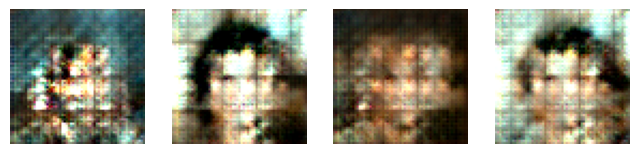

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 344ms/step - Disc Loss: 0.4188 - Gen Loss: 2.4163
Epoch 97/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step - Disc Loss: 0.4005 - Gen Loss: 2.5976

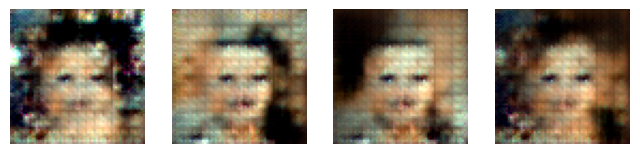

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 345ms/step - Disc Loss: 0.4005 - Gen Loss: 2.5970
Epoch 98/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - Disc Loss: 0.3954 - Gen Loss: 3.0131

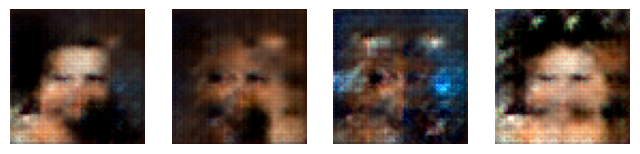

203/203 ━━━━━━━━━━━━━━━━━━━━ 73s 348ms/step - Disc Loss: 0.3963 - Gen Loss: 3.0125
Epoch 99/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 546ms/step - Disc Loss: 0.3505 - Gen Loss: 3.3153

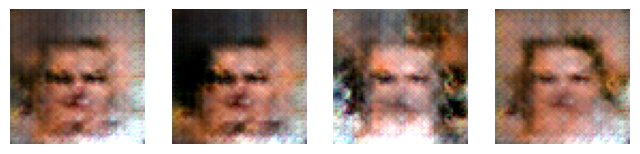

203/203 ━━━━━━━━━━━━━━━━━━━━ 114s 547ms/step - Disc Loss: 0.3505 - Gen Loss: 3.3117
Epoch 100/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step - Disc Loss: 0.3741 - Gen Loss: 2.6684

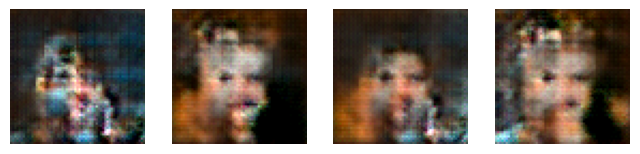

203/203 ━━━━━━━━━━━━━━━━━━━━ 79s 377ms/step - Disc Loss: 0.3742 - Gen Loss: 2.6683
Epoch 101/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - Disc Loss: 0.3182 - Gen Loss: 2.8603

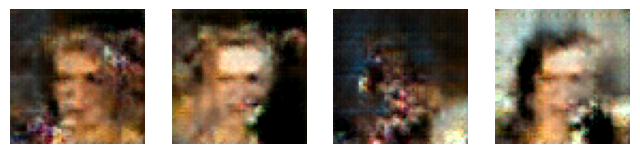

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 341ms/step - Disc Loss: 0.3188 - Gen Loss: 2.8582
Epoch 102/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 572ms/step - Disc Loss: 0.4681 - Gen Loss: 2.9275

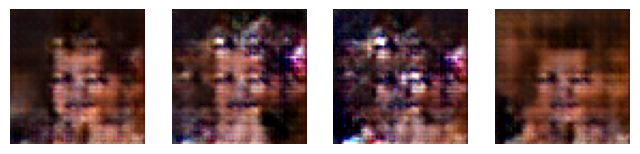

203/203 ━━━━━━━━━━━━━━━━━━━━ 118s 573ms/step - Disc Loss: 0.4686 - Gen Loss: 2.9287
Epoch 103/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - Disc Loss: 0.4224 - Gen Loss: 3.0218

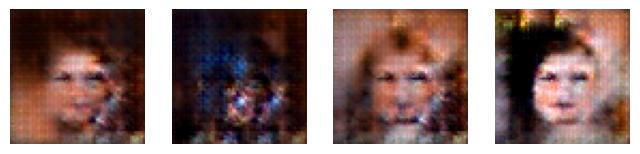

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 355ms/step - Disc Loss: 0.4225 - Gen Loss: 3.0205
Epoch 104/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step - Disc Loss: 0.3135 - Gen Loss: 2.9199

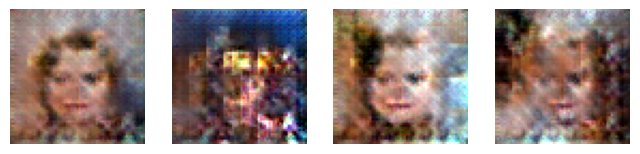

203/203 ━━━━━━━━━━━━━━━━━━━━ 73s 351ms/step - Disc Loss: 0.3131 - Gen Loss: 2.9183
Epoch 105/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - Disc Loss: 0.3511 - Gen Loss: 2.7763

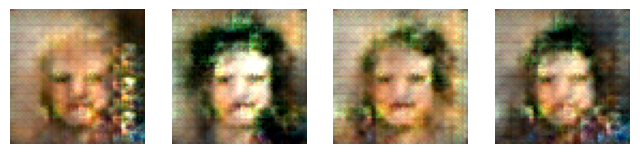

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 354ms/step - Disc Loss: 0.3504 - Gen Loss: 2.7783
Epoch 106/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step - Disc Loss: 0.4624 - Gen Loss: 2.6242

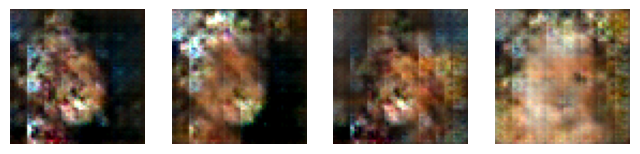

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 330ms/step - Disc Loss: 0.4623 - Gen Loss: 2.6213
Epoch 107/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - Disc Loss: 0.3922 - Gen Loss: 2.7575

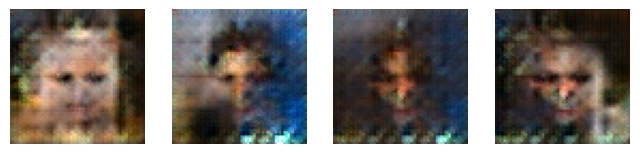

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 347ms/step - Disc Loss: 0.3920 - Gen Loss: 2.7589
Epoch 108/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - Disc Loss: 0.4061 - Gen Loss: 2.9129

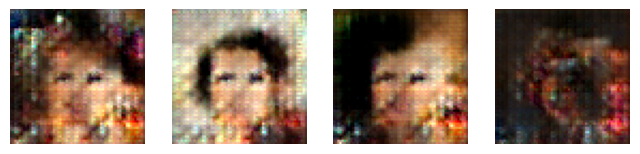

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 339ms/step - Disc Loss: 0.4052 - Gen Loss: 2.9161
Epoch 109/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step - Disc Loss: 0.3719 - Gen Loss: 2.8741

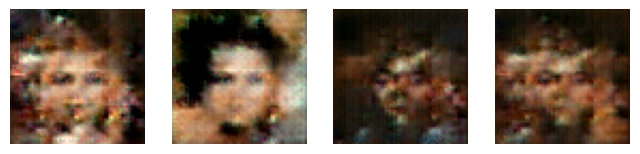

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 327ms/step - Disc Loss: 0.3713 - Gen Loss: 2.8750
Epoch 110/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step - Disc Loss: 0.3500 - Gen Loss: 2.7563

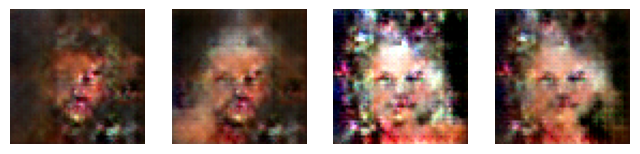

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 323ms/step - Disc Loss: 0.3505 - Gen Loss: 2.7553
Epoch 111/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - Disc Loss: 0.3619 - Gen Loss: 2.7980

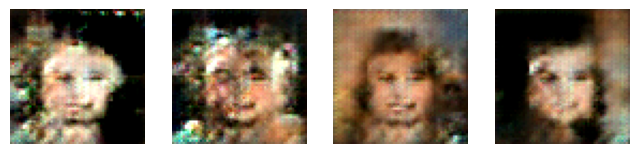

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 321ms/step - Disc Loss: 0.3617 - Gen Loss: 2.7991
Epoch 112/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - Disc Loss: 0.3888 - Gen Loss: 3.0600

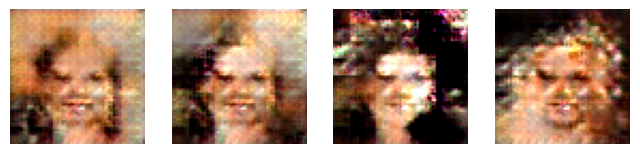

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 354ms/step - Disc Loss: 0.3884 - Gen Loss: 3.0616
Epoch 113/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step - Disc Loss: 0.4486 - Gen Loss: 3.0129

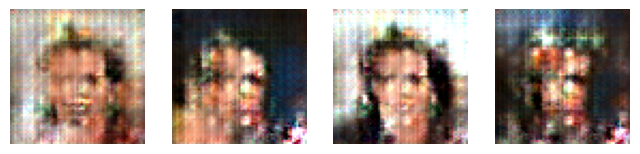

203/203 ━━━━━━━━━━━━━━━━━━━━ 92s 444ms/step - Disc Loss: 0.4477 - Gen Loss: 3.0177
Epoch 114/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 501ms/step - Disc Loss: 0.4500 - Gen Loss: 3.3384

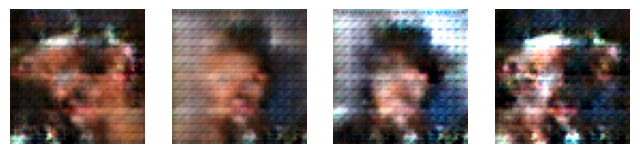

203/203 ━━━━━━━━━━━━━━━━━━━━ 105s 502ms/step - Disc Loss: 0.4489 - Gen Loss: 3.3403
Epoch 115/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step - Disc Loss: 0.3185 - Gen Loss: 3.1648

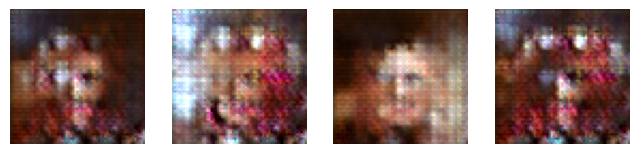

203/203 ━━━━━━━━━━━━━━━━━━━━ 92s 443ms/step - Disc Loss: 0.3187 - Gen Loss: 3.1687
Epoch 116/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 500ms/step - Disc Loss: 0.2455 - Gen Loss: 3.8036

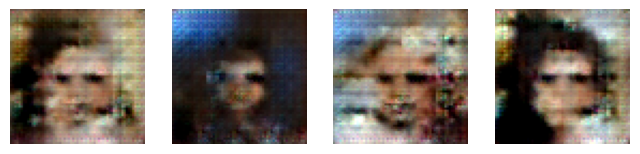

203/203 ━━━━━━━━━━━━━━━━━━━━ 104s 501ms/step - Disc Loss: 0.2455 - Gen Loss: 3.8006
Epoch 117/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step - Disc Loss: 0.3398 - Gen Loss: 2.8787

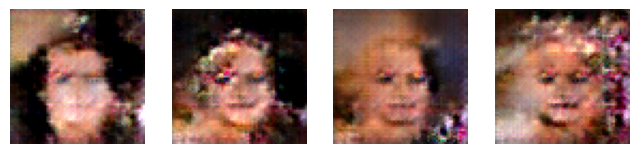

203/203 ━━━━━━━━━━━━━━━━━━━━ 78s 375ms/step - Disc Loss: 0.3389 - Gen Loss: 2.8812
Epoch 118/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step - Disc Loss: 0.3464 - Gen Loss: 2.9931

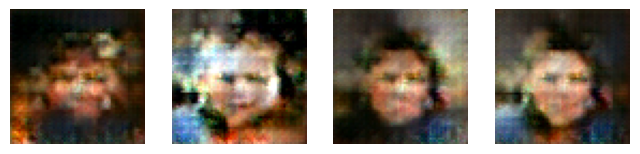

203/203 ━━━━━━━━━━━━━━━━━━━━ 81s 391ms/step - Disc Loss: 0.3473 - Gen Loss: 2.9905
Epoch 119/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 448ms/step - Disc Loss: 0.2966 - Gen Loss: 2.9623

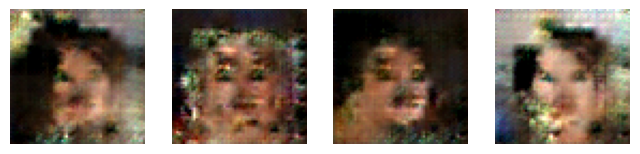

203/203 ━━━━━━━━━━━━━━━━━━━━ 94s 449ms/step - Disc Loss: 0.2964 - Gen Loss: 2.9624
Epoch 120/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 416ms/step - Disc Loss: 0.3905 - Gen Loss: 2.8779

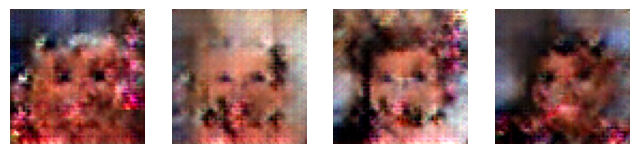

203/203 ━━━━━━━━━━━━━━━━━━━━ 87s 417ms/step - Disc Loss: 0.3904 - Gen Loss: 2.8802
Epoch 121/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 395ms/step - Disc Loss: 0.3738 - Gen Loss: 2.6792

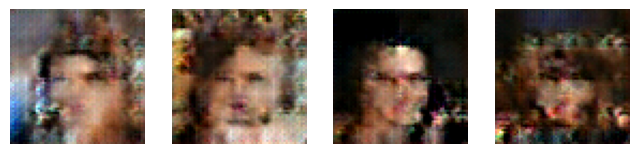

203/203 ━━━━━━━━━━━━━━━━━━━━ 83s 396ms/step - Disc Loss: 0.3755 - Gen Loss: 2.6762
Epoch 122/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 420ms/step - Disc Loss: 0.3348 - Gen Loss: 3.1388

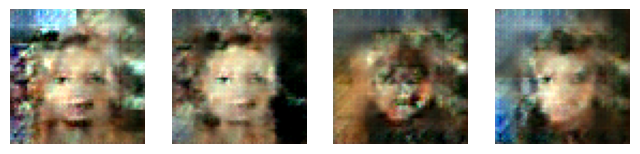

203/203 ━━━━━━━━━━━━━━━━━━━━ 89s 421ms/step - Disc Loss: 0.3342 - Gen Loss: 3.1396
Epoch 123/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step - Disc Loss: 0.3708 - Gen Loss: 2.8538

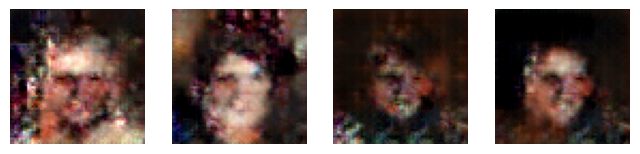

203/203 ━━━━━━━━━━━━━━━━━━━━ 79s 378ms/step - Disc Loss: 0.3703 - Gen Loss: 2.8538
Epoch 124/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step - Disc Loss: 0.2878 - Gen Loss: 3.1855

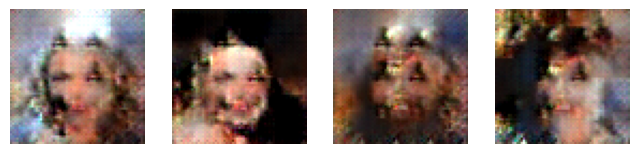

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 366ms/step - Disc Loss: 0.2873 - Gen Loss: 3.1856
Epoch 125/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 375ms/step - Disc Loss: 0.3481 - Gen Loss: 3.1256

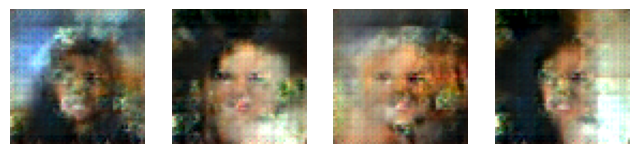

203/203 ━━━━━━━━━━━━━━━━━━━━ 78s 376ms/step - Disc Loss: 0.3470 - Gen Loss: 3.1284
Epoch 126/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step - Disc Loss: 0.4204 - Gen Loss: 3.0611

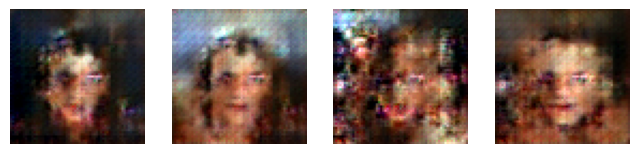

203/203 ━━━━━━━━━━━━━━━━━━━━ 90s 434ms/step - Disc Loss: 0.4213 - Gen Loss: 3.0567
Epoch 127/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 431ms/step - Disc Loss: 0.3311 - Gen Loss: 2.6734

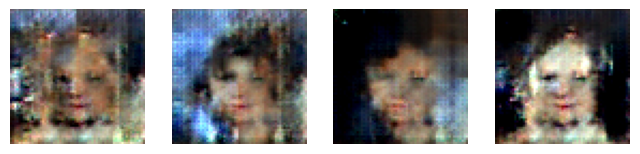

203/203 ━━━━━━━━━━━━━━━━━━━━ 90s 432ms/step - Disc Loss: 0.3309 - Gen Loss: 2.6731
Epoch 128/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step - Disc Loss: 0.3070 - Gen Loss: 3.0382

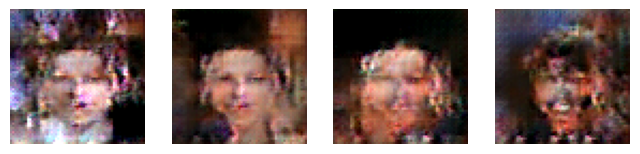

203/203 ━━━━━━━━━━━━━━━━━━━━ 82s 391ms/step - Disc Loss: 0.3073 - Gen Loss: 3.0365
Epoch 129/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 363ms/step - Disc Loss: 0.2959 - Gen Loss: 2.9806

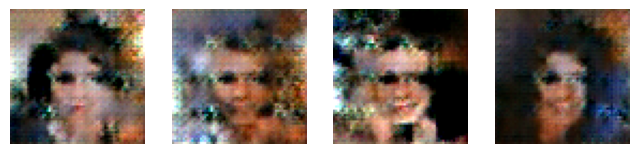

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 363ms/step - Disc Loss: 0.2955 - Gen Loss: 2.9823
Epoch 130/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 368ms/step - Disc Loss: 0.3234 - Gen Loss: 3.1590

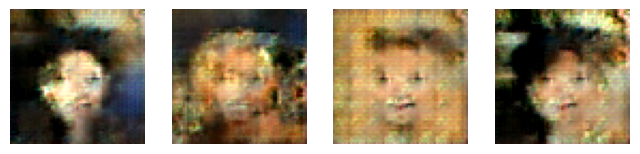

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 370ms/step - Disc Loss: 0.3229 - Gen Loss: 3.1585
Epoch 131/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 436ms/step - Disc Loss: 0.3014 - Gen Loss: 3.0838

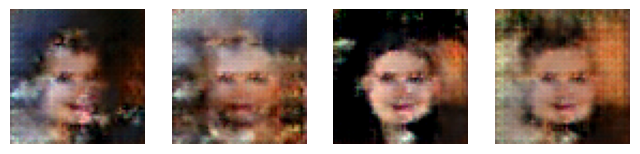

203/203 ━━━━━━━━━━━━━━━━━━━━ 91s 436ms/step - Disc Loss: 0.3007 - Gen Loss: 3.0853
Epoch 132/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step - Disc Loss: 0.3198 - Gen Loss: 3.4064

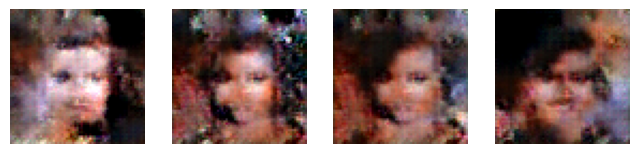

203/203 ━━━━━━━━━━━━━━━━━━━━ 88s 420ms/step - Disc Loss: 0.3196 - Gen Loss: 3.4074
Epoch 133/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step - Disc Loss: 0.3075 - Gen Loss: 2.9722

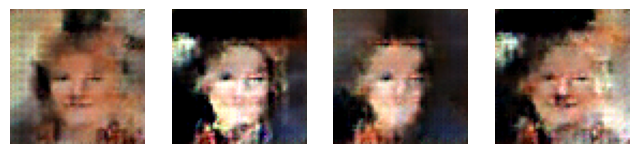

203/203 ━━━━━━━━━━━━━━━━━━━━ 79s 378ms/step - Disc Loss: 0.3077 - Gen Loss: 2.9731
Epoch 134/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step - Disc Loss: 0.2824 - Gen Loss: 3.2435

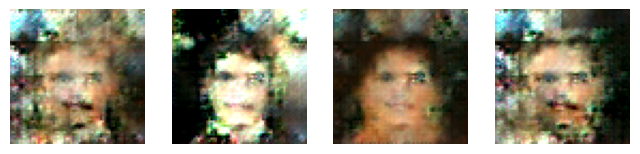

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 353ms/step - Disc Loss: 0.2819 - Gen Loss: 3.2426
Epoch 135/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - Disc Loss: 0.2653 - Gen Loss: 3.4090

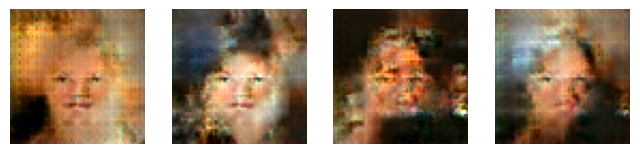

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 322ms/step - Disc Loss: 0.2661 - Gen Loss: 3.4111
Epoch 136/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - Disc Loss: 0.3256 - Gen Loss: 3.1440

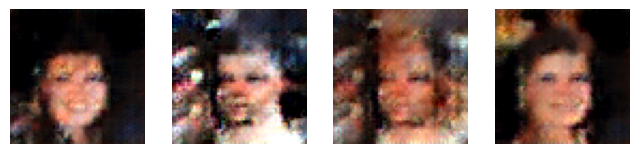

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 314ms/step - Disc Loss: 0.3266 - Gen Loss: 3.1391
Epoch 137/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.2783 - Gen Loss: 3.4045

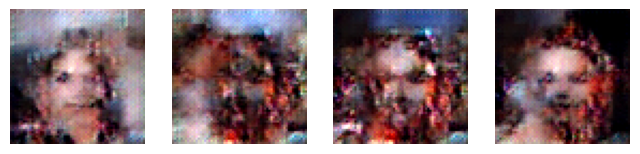

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.2774 - Gen Loss: 3.4064
Epoch 138/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step - Disc Loss: 0.2985 - Gen Loss: 3.2757

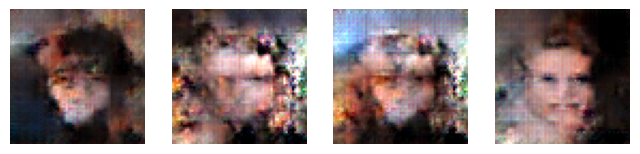

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 329ms/step - Disc Loss: 0.2980 - Gen Loss: 3.2795
Epoch 139/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - Disc Loss: 0.3285 - Gen Loss: 3.3566

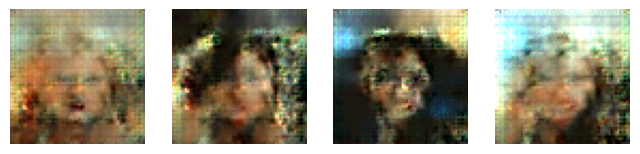

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 317ms/step - Disc Loss: 0.3281 - Gen Loss: 3.3548
Epoch 140/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step - Disc Loss: 0.3008 - Gen Loss: 3.3825

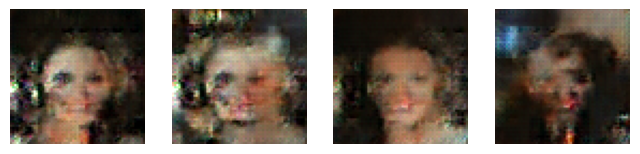

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 342ms/step - Disc Loss: 0.3003 - Gen Loss: 3.3819
Epoch 141/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 380ms/step - Disc Loss: 0.3046 - Gen Loss: 3.2546

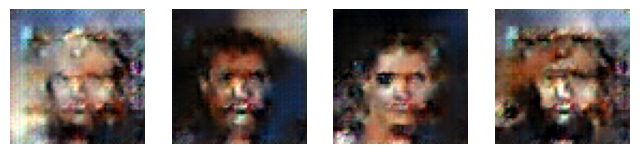

203/203 ━━━━━━━━━━━━━━━━━━━━ 80s 381ms/step - Disc Loss: 0.3040 - Gen Loss: 3.2564
Epoch 142/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step - Disc Loss: 0.2640 - Gen Loss: 3.5306

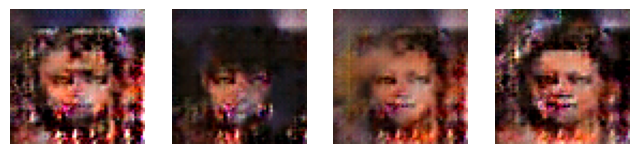

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 338ms/step - Disc Loss: 0.2639 - Gen Loss: 3.5351
Epoch 143/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step - Disc Loss: 0.3073 - Gen Loss: 3.4374

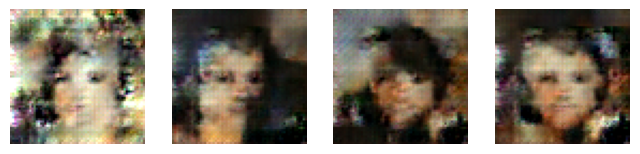

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 354ms/step - Disc Loss: 0.3073 - Gen Loss: 3.4368
Epoch 144/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 330ms/step - Disc Loss: 0.2403 - Gen Loss: 3.5926

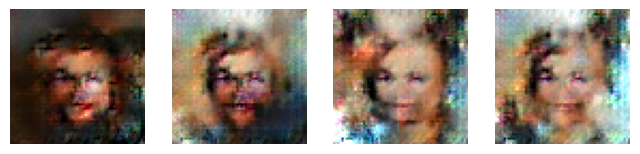

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 331ms/step - Disc Loss: 0.2428 - Gen Loss: 3.5893
Epoch 145/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step - Disc Loss: 0.2658 - Gen Loss: 3.5756

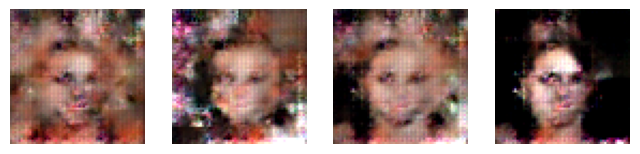

203/203 ━━━━━━━━━━━━━━━━━━━━ 81s 382ms/step - Disc Loss: 0.2654 - Gen Loss: 3.5768
Epoch 146/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 647ms/step - Disc Loss: 0.2672 - Gen Loss: 3.5898

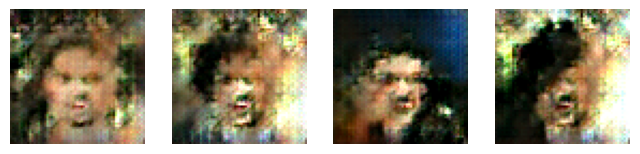

203/203 ━━━━━━━━━━━━━━━━━━━━ 134s 647ms/step - Disc Loss: 0.2667 - Gen Loss: 3.5887
Epoch 147/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step - Disc Loss: 0.2549 - Gen Loss: 3.1877

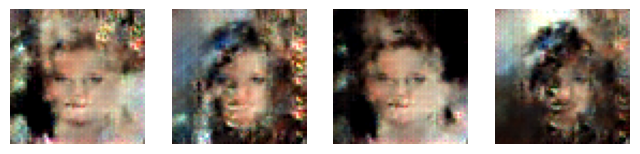

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 338ms/step - Disc Loss: 0.2546 - Gen Loss: 3.1877
Epoch 148/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - Disc Loss: 0.2403 - Gen Loss: 3.4273

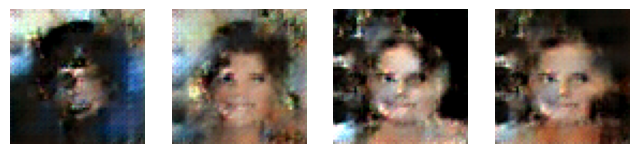

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 345ms/step - Disc Loss: 0.2396 - Gen Loss: 3.4279
Epoch 149/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step - Disc Loss: 0.2493 - Gen Loss: 3.4508

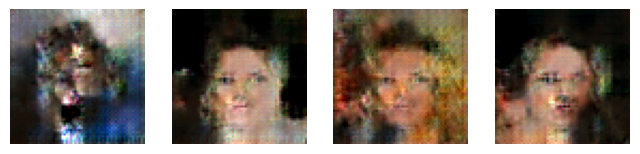

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 335ms/step - Disc Loss: 0.2494 - Gen Loss: 3.4481
Epoch 150/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step - Disc Loss: 0.2497 - Gen Loss: 3.3854

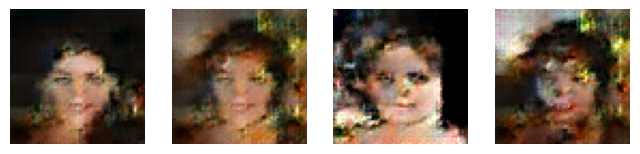

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 354ms/step - Disc Loss: 0.2497 - Gen Loss: 3.3858
Epoch 151/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step - Disc Loss: 0.2552 - Gen Loss: 3.3163

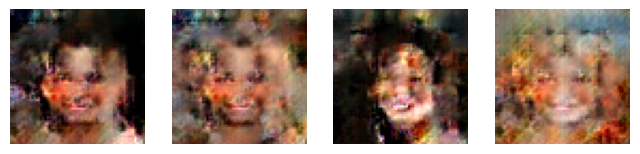

203/203 ━━━━━━━━━━━━━━━━━━━━ 63s 299ms/step - Disc Loss: 0.2557 - Gen Loss: 3.3166
Epoch 152/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - Disc Loss: 0.2721 - Gen Loss: 3.2632

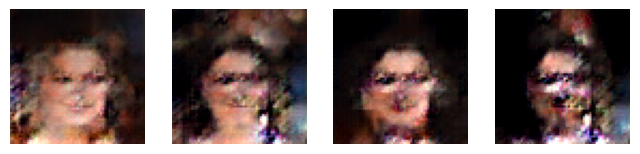

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 315ms/step - Disc Loss: 0.2719 - Gen Loss: 3.2644
Epoch 153/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - Disc Loss: 0.2562 - Gen Loss: 3.5448

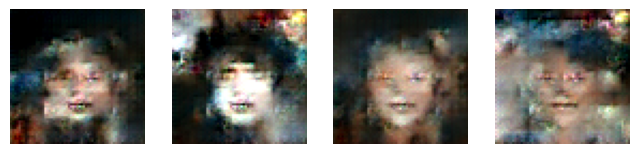

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 313ms/step - Disc Loss: 0.2566 - Gen Loss: 3.5464
Epoch 154/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - Disc Loss: 0.2634 - Gen Loss: 3.3849

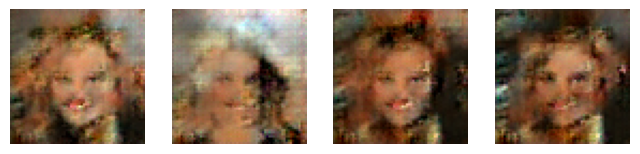

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 309ms/step - Disc Loss: 0.2632 - Gen Loss: 3.3842
Epoch 155/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - Disc Loss: 0.2595 - Gen Loss: 3.3938

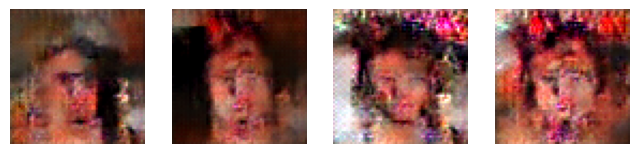

203/203 ━━━━━━━━━━━━━━━━━━━━ 72s 347ms/step - Disc Loss: 0.2597 - Gen Loss: 3.3982
Epoch 156/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - Disc Loss: 0.2696 - Gen Loss: 3.3882

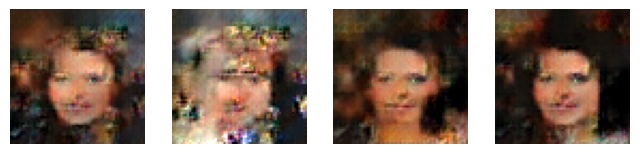

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 319ms/step - Disc Loss: 0.2718 - Gen Loss: 3.3881
Epoch 157/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step - Disc Loss: 0.2542 - Gen Loss: 3.4359

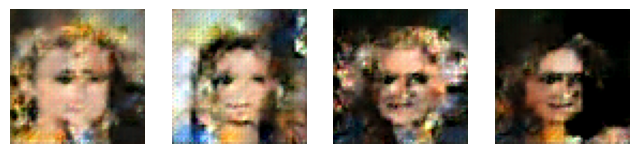

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 328ms/step - Disc Loss: 0.2535 - Gen Loss: 3.4375
Epoch 158/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - Disc Loss: 0.3314 - Gen Loss: 3.3815

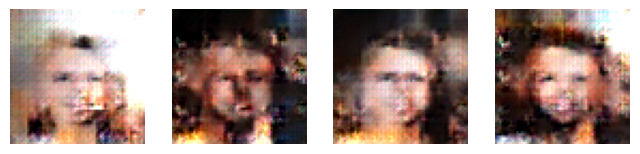

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 319ms/step - Disc Loss: 0.3306 - Gen Loss: 3.3840
Epoch 159/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step - Disc Loss: 0.2878 - Gen Loss: 3.3208

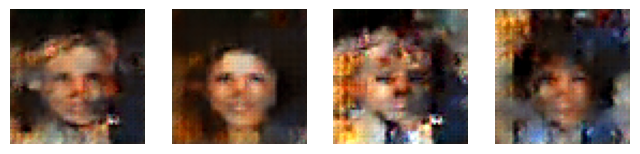

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 322ms/step - Disc Loss: 0.2875 - Gen Loss: 3.3199
Epoch 160/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 366ms/step - Disc Loss: 0.2113 - Gen Loss: 3.1797

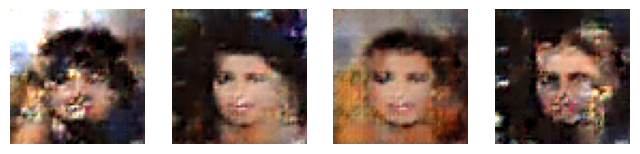

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 366ms/step - Disc Loss: 0.2119 - Gen Loss: 3.1793
Epoch 161/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - Disc Loss: 0.2597 - Gen Loss: 3.3998

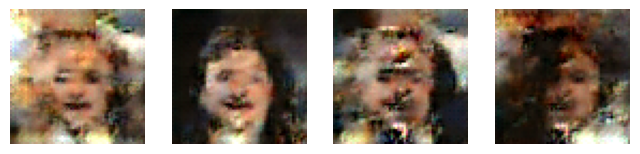

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 310ms/step - Disc Loss: 0.2598 - Gen Loss: 3.3979
Epoch 162/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - Disc Loss: 0.2814 - Gen Loss: 3.2812

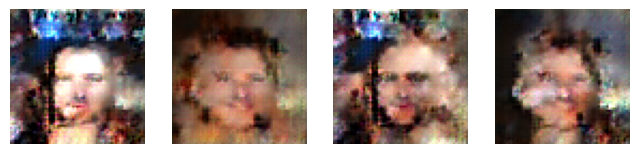

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 312ms/step - Disc Loss: 0.2825 - Gen Loss: 3.2788
Epoch 163/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step - Disc Loss: 0.2746 - Gen Loss: 3.2623

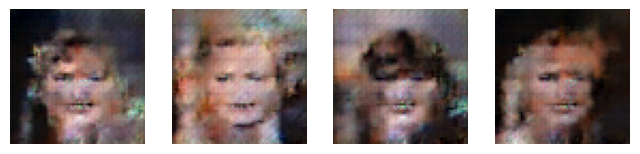

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 358ms/step - Disc Loss: 0.2739 - Gen Loss: 3.2655
Epoch 164/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step - Disc Loss: 0.2446 - Gen Loss: 3.0681

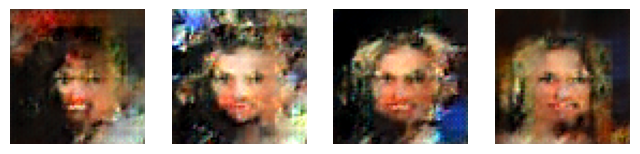

203/203 ━━━━━━━━━━━━━━━━━━━━ 79s 382ms/step - Disc Loss: 0.2451 - Gen Loss: 3.0664
Epoch 165/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 352ms/step - Disc Loss: 0.2654 - Gen Loss: 3.3085

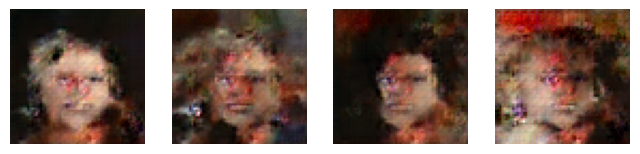

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 353ms/step - Disc Loss: 0.2646 - Gen Loss: 3.3094
Epoch 166/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - Disc Loss: 0.3264 - Gen Loss: 3.1359

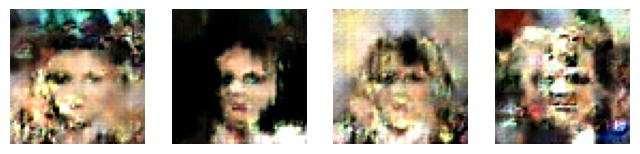

203/203 ━━━━━━━━━━━━━━━━━━━━ 76s 345ms/step - Disc Loss: 0.3268 - Gen Loss: 3.1354
Epoch 167/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 396ms/step - Disc Loss: 0.2781 - Gen Loss: 3.4407

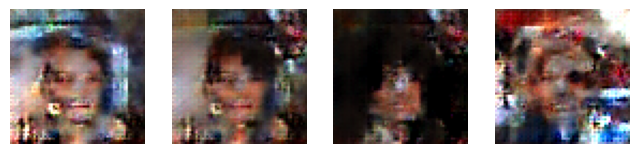

203/203 ━━━━━━━━━━━━━━━━━━━━ 88s 396ms/step - Disc Loss: 0.2782 - Gen Loss: 3.4386
Epoch 168/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 353ms/step - Disc Loss: 0.2569 - Gen Loss: 3.2490

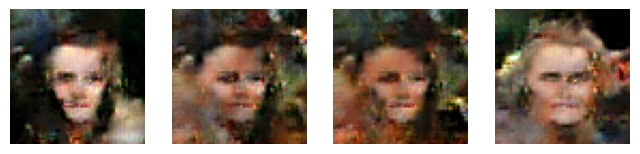

203/203 ━━━━━━━━━━━━━━━━━━━━ 75s 354ms/step - Disc Loss: 0.2564 - Gen Loss: 3.2500
Epoch 169/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - Disc Loss: 0.2508 - Gen Loss: 3.3891

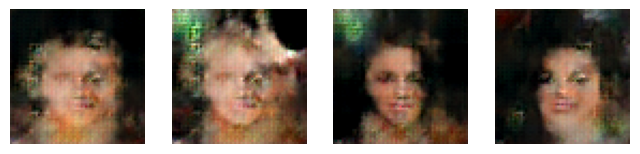

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 310ms/step - Disc Loss: 0.2512 - Gen Loss: 3.3868
Epoch 170/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.2199 - Gen Loss: 3.7044

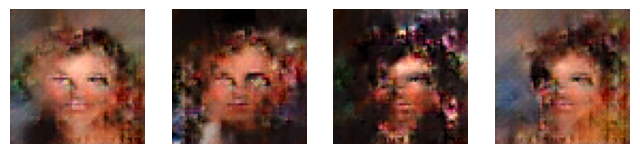

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.2195 - Gen Loss: 3.7028
Epoch 171/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step - Disc Loss: 0.2267 - Gen Loss: 3.6715

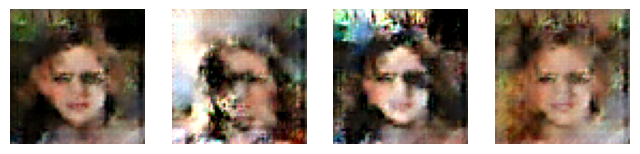

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 351ms/step - Disc Loss: 0.2262 - Gen Loss: 3.6728
Epoch 172/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step - Disc Loss: 0.2160 - Gen Loss: 3.5956

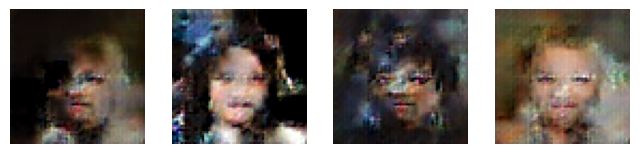

203/203 ━━━━━━━━━━━━━━━━━━━━ 82s 395ms/step - Disc Loss: 0.2162 - Gen Loss: 3.5948
Epoch 173/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - Disc Loss: 0.2494 - Gen Loss: 3.3895

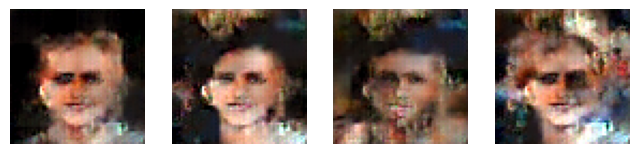

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 341ms/step - Disc Loss: 0.2492 - Gen Loss: 3.3948
Epoch 174/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step - Disc Loss: 0.2237 - Gen Loss: 3.8536

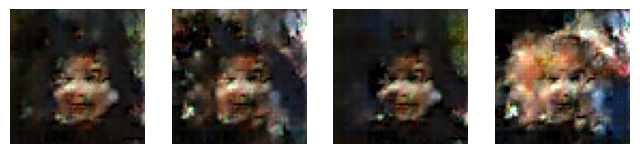

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 326ms/step - Disc Loss: 0.2239 - Gen Loss: 3.8514
Epoch 175/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 355ms/step - Disc Loss: 0.2054 - Gen Loss: 3.8700

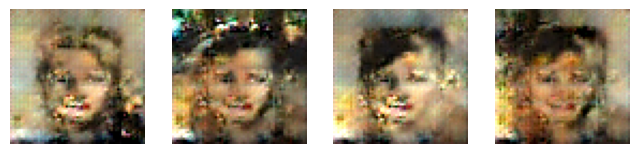

203/203 ━━━━━━━━━━━━━━━━━━━━ 74s 356ms/step - Disc Loss: 0.2053 - Gen Loss: 3.8711
Epoch 176/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step - Disc Loss: 0.2070 - Gen Loss: 3.7021

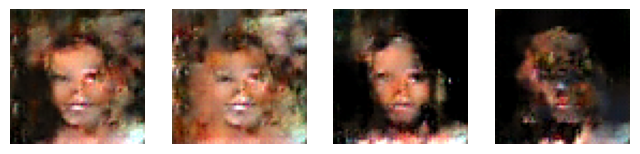

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 330ms/step - Disc Loss: 0.2073 - Gen Loss: 3.6996
Epoch 177/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - Disc Loss: 0.2233 - Gen Loss: 3.9355

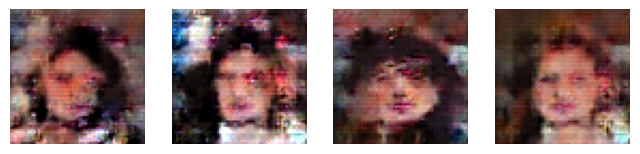

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 319ms/step - Disc Loss: 0.2231 - Gen Loss: 3.9343
Epoch 178/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 376ms/step - Disc Loss: 0.2191 - Gen Loss: 3.6748

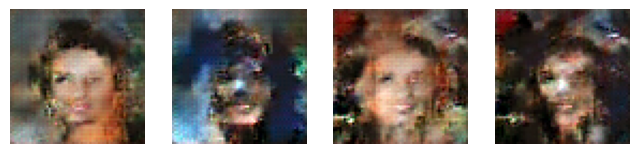

203/203 ━━━━━━━━━━━━━━━━━━━━ 79s 377ms/step - Disc Loss: 0.2192 - Gen Loss: 3.6751
Epoch 179/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - Disc Loss: 0.2253 - Gen Loss: 3.8221

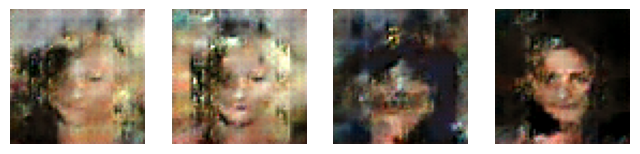

203/203 ━━━━━━━━━━━━━━━━━━━━ 84s 405ms/step - Disc Loss: 0.2256 - Gen Loss: 3.8205
Epoch 180/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step - Disc Loss: 0.2120 - Gen Loss: 3.8717

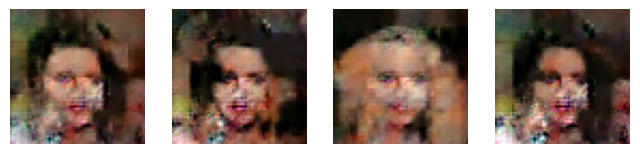

203/203 ━━━━━━━━━━━━━━━━━━━━ 73s 349ms/step - Disc Loss: 0.2116 - Gen Loss: 3.8724
Epoch 181/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - Disc Loss: 0.1980 - Gen Loss: 3.7538

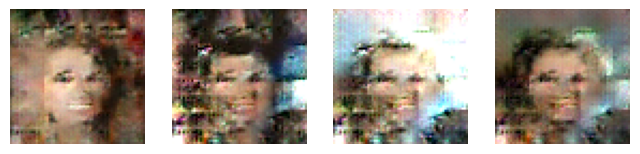

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 321ms/step - Disc Loss: 0.1976 - Gen Loss: 3.7573
Epoch 182/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 374ms/step - Disc Loss: 0.2062 - Gen Loss: 3.6041

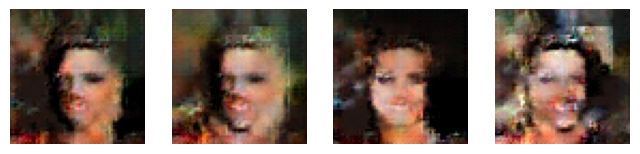

203/203 ━━━━━━━━━━━━━━━━━━━━ 78s 375ms/step - Disc Loss: 0.2063 - Gen Loss: 3.6031
Epoch 183/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 339ms/step - Disc Loss: 0.2026 - Gen Loss: 3.9868

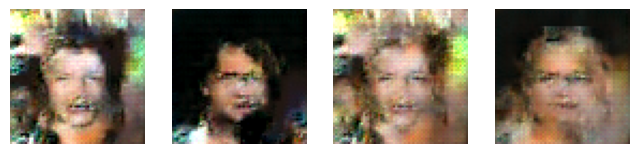

203/203 ━━━━━━━━━━━━━━━━━━━━ 71s 340ms/step - Disc Loss: 0.2036 - Gen Loss: 3.9895
Epoch 184/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - Disc Loss: 0.2284 - Gen Loss: 3.8591

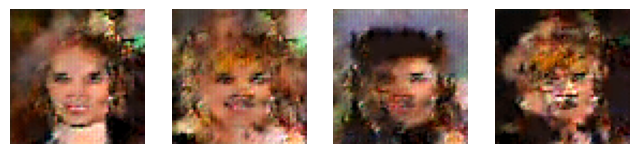

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 325ms/step - Disc Loss: 0.2291 - Gen Loss: 3.8588
Epoch 185/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step - Disc Loss: 0.2311 - Gen Loss: 3.7286

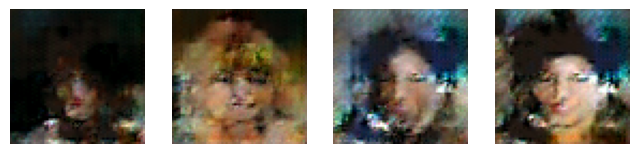

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 327ms/step - Disc Loss: 0.2309 - Gen Loss: 3.7299
Epoch 186/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 391ms/step - Disc Loss: 0.2092 - Gen Loss: 3.8659

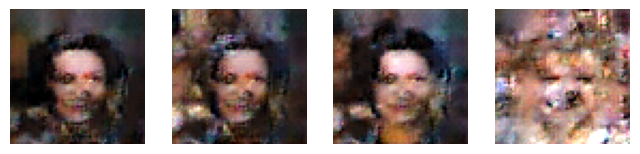

203/203 ━━━━━━━━━━━━━━━━━━━━ 81s 392ms/step - Disc Loss: 0.2094 - Gen Loss: 3.8630
Epoch 187/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step - Disc Loss: 0.2310 - Gen Loss: 3.6951

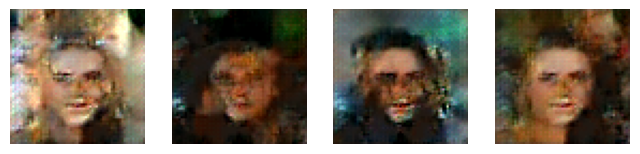

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 370ms/step - Disc Loss: 0.2307 - Gen Loss: 3.6955
Epoch 188/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 328ms/step - Disc Loss: 0.2213 - Gen Loss: 3.7519

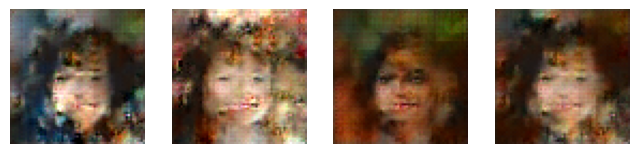

203/203 ━━━━━━━━━━━━━━━━━━━━ 69s 328ms/step - Disc Loss: 0.2212 - Gen Loss: 3.7509
Epoch 189/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 331ms/step - Disc Loss: 0.2001 - Gen Loss: 4.1340

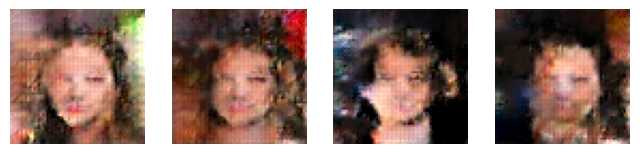

203/203 ━━━━━━━━━━━━━━━━━━━━ 70s 332ms/step - Disc Loss: 0.1997 - Gen Loss: 4.1386
Epoch 190/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step - Disc Loss: 0.1881 - Gen Loss: 3.8354

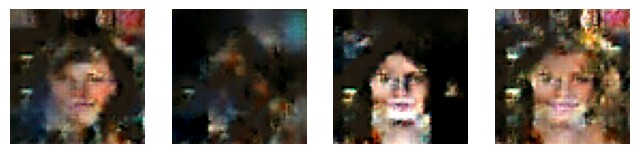

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 328ms/step - Disc Loss: 0.1877 - Gen Loss: 3.8376
Epoch 191/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - Disc Loss: 0.1913 - Gen Loss: 3.7524

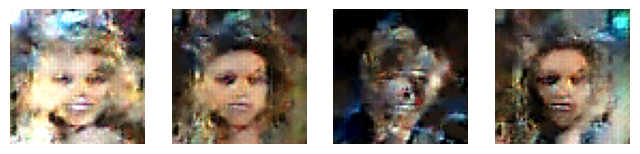

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 320ms/step - Disc Loss: 0.1912 - Gen Loss: 3.7492
Epoch 192/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - Disc Loss: 0.2237 - Gen Loss: 3.8969

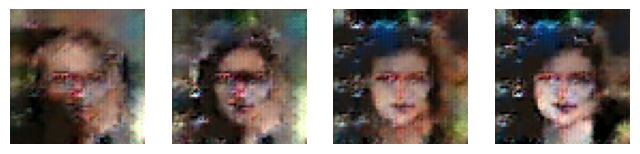

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 319ms/step - Disc Loss: 0.2234 - Gen Loss: 3.8956
Epoch 193/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - Disc Loss: 0.2268 - Gen Loss: 4.0164

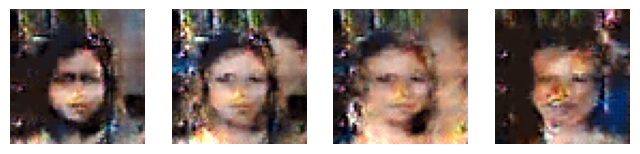

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 309ms/step - Disc Loss: 0.2265 - Gen Loss: 4.0148
Epoch 194/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - Disc Loss: 0.2334 - Gen Loss: 3.6316

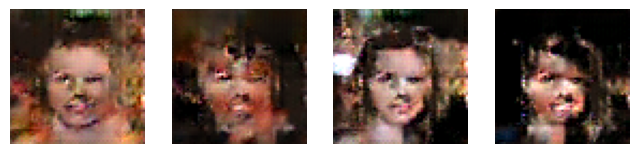

203/203 ━━━━━━━━━━━━━━━━━━━━ 65s 313ms/step - Disc Loss: 0.2329 - Gen Loss: 3.6327
Epoch 195/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - Disc Loss: 0.2128 - Gen Loss: 3.5692

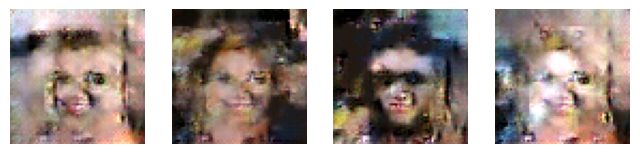

203/203 ━━━━━━━━━━━━━━━━━━━━ 66s 316ms/step - Disc Loss: 0.2131 - Gen Loss: 3.5701
Epoch 196/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - Disc Loss: 0.2127 - Gen Loss: 3.7175

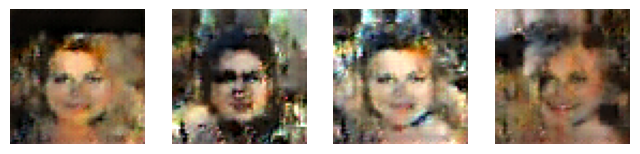

203/203 ━━━━━━━━━━━━━━━━━━━━ 68s 325ms/step - Disc Loss: 0.2129 - Gen Loss: 3.7150
Epoch 197/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - Disc Loss: 0.2048 - Gen Loss: 3.7898

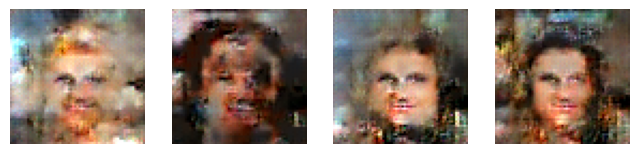

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 322ms/step - Disc Loss: 0.2042 - Gen Loss: 3.7878
Epoch 198/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step - Disc Loss: 0.2335 - Gen Loss: 3.9793

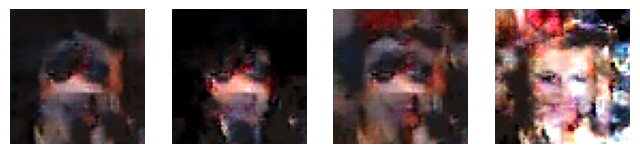

203/203 ━━━━━━━━━━━━━━━━━━━━ 67s 322ms/step - Disc Loss: 0.2351 - Gen Loss: 3.9849
Epoch 199/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 369ms/step - Disc Loss: 0.1992 - Gen Loss: 3.9003

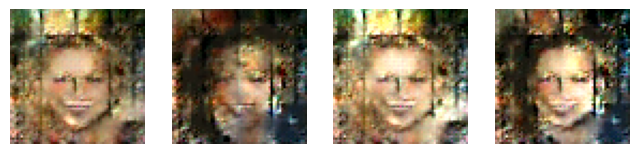

203/203 ━━━━━━━━━━━━━━━━━━━━ 77s 370ms/step - Disc Loss: 0.1991 - Gen Loss: 3.9021
Epoch 200/200
203/203 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step - Disc Loss: 0.2088 - Gen Loss: 3.8049

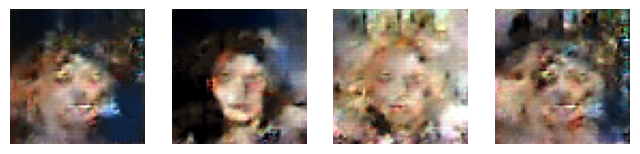

203/203 ━━━━━━━━━━━━━━━━━━━━ 79s 379ms/step - Disc Loss: 0.2091 - Gen Loss: 3.8038


In [13]:
disc_model=Discriminator(LATENT_DIM)
gen_model=Generator(LATENT_DIM)

gan=GAN(discriminator=disc_model,generator=gen_model,latent_dim=LATENT_DIM)
gan.compile(
    disc_optimizer=disc_optimizer,
    gen_optimizer=gen_optimizer,
    loss_fn=cross_entropy,
    batch_size=batch_size
)

training_callback=Training_Callback(latent_dim=LATENT_DIM)
gan.fit(
    celebA_dataset,
    epochs=epochs,
    callbacks=[training_callback]
)

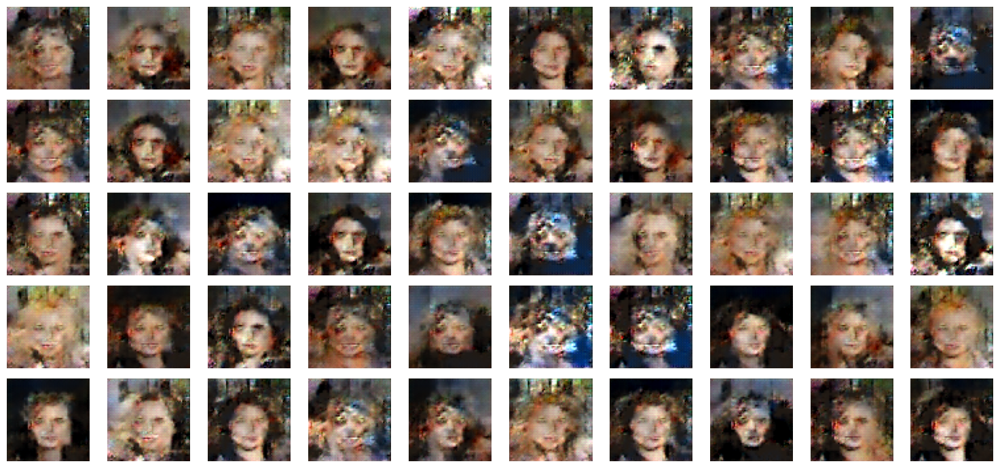

In [14]:
random_latent_vectors=tf.random.normal([50,LATENT_DIM])
generated_images=gen_model(random_latent_vectors,training=False)

fig, axes = plt.subplots(5, 10, figsize=(15, 7))  # 5 rows, 10 columns
for i, ax in enumerate(axes.flatten()):
    ax.imshow(generated_images[i])
    ax.axis('off')

plt.tight_layout()
plt.show()